In [1]:
from kneed import KneeLocator
from matplotlib import pyplot as plt
from matplotlib.cm import cool
from matplotlib.colors import LogNorm
from sklearn.cluster import KMeans
from sklearn.cluster import SpectralClustering
from sklearn.decomposition import PCA
from sklearn.metrics import calinski_harabasz_score
from sklearn.metrics import pairwise_distances
from sklearn.metrics import silhouette_score
from sklearn.mixture import GaussianMixture

import matplotlib as mpl
import numpy as np
import pandas as pd
import warnings

warnings.filterwarnings('ignore')

In [2]:
raw_df = pd.read_csv('./transfermarkt_fbref_201920.csv', delimiter=';')

Define 3 sets of statistics:
    <ol>
    <li>All</li>
    <li>Outfield only</li>
    <li>Goalkeeper only</li>
    </ol>

Each set will be downselected to only contain quantitative factors that have not already been normalized

In [3]:
columns_all = [
'goals',
'assists',
'pens_made',
'pens_att',
'cards_yellow',
'cards_red',
'xg',
'npxg',
'xa',
'shots_total',
'shots_on_target',
'shots_free_kicks',
'shots_on_target_pct',
'goals_per_shot',
'goals_per_shot_on_target',
'npxg_per_shot',
'xg_net',
'npxg_net',
'passes_completed',
'passes',
'passes_pct',
'passes_total_distance',
'passes_progressive_distance',
'passes_completed_short',
'passes_short',
'passes_pct_short',
'passes_completed_medium',
'passes_medium',
'passes_pct_medium',
'passes_completed_long',
'passes_long',
'passes_pct_long',
'xa_net',
'assisted_shots',
'passes_into_final_third',
'passes_into_penalty_area',
'crosses_into_penalty_area',
'progressive_passes',
'passes_live',
'passes_dead',
'passes_free_kicks',
'through_balls',
'passes_pressure',
'passes_switches',
'crosses',
'corner_kicks',
'corner_kicks_in',
'corner_kicks_out',
'corner_kicks_straight',
'passes_ground',
'passes_low',
'passes_high',
'passes_left_foot',
'passes_right_foot',
'passes_head',
'throw_ins',
'passes_other_body',
'passes_offsides',
'passes_oob',
'passes_intercepted',
'passes_blocked',
'sca',
'sca_passes_live',
'sca_passes_dead',
'sca_dribbles',
'sca_shots',
'sca_fouled',
'gca',
'gca_passes_live',
'gca_passes_dead',
'gca_dribbles',
'gca_shots',
'gca_fouled',
'gca_og_for',
'tackles',
'tackles_won',
'tackles_def_3rd',
'tackles_mid_3rd',
'tackles_att_3rd',
'dribble_tackles',
'dribbles_vs',
'dribble_tackles_pct',
'dribbled_past',
'pressures',
'pressure_regains',
'pressure_regain_pct',
'pressures_def_3rd',
'pressures_mid_3rd',
'pressures_att_3rd',
'blocks',
'blocked_shots',
'blocked_shots_saves',
'blocked_passes',
'interceptions',
'clearances',
'errors',
'touches',
'touches_def_pen_area',
'touches_def_3rd',
'touches_mid_3rd',
'touches_att_3rd',
'touches_att_pen_area',
'touches_live_ball',
'dribbles_completed',
'dribbles',
'dribbles_completed_pct',
'players_dribbled_past',
'nutmegs',
'carries',
'carry_distance',
'carry_progressive_distance',
'pass_targets',
'passes_received',
'passes_received_pct',
'miscontrols',
'dispossessed',
'cards_yellow_red',
'fouls',
'fouled',
'offsides',
'pens_won',
'pens_conceded',
'own_goals',
'ball_recoveries',
'aerials_won',
'aerials_lost',
'aerials_won_pct',
'goals_against_gk',
'shots_on_target_against',
'saves',
'save_pct',
'pens_allowed',
'pens_saved',
'pens_missed_gk',
'free_kick_goals_against_gk',
'corner_kick_goals_against_gk',
'own_goals_against_gk',
'psxg_gk',
'psnpxg_per_shot_on_target_against',
'psxg_net_gk',
'passes_completed_launched_gk',
'passes_launched_gk',
'passes_pct_launched_gk',
'passes_gk',
'passes_throws_gk',
'pct_passes_launched_gk',
'passes_length_avg_gk',
'goal_kicks',
'pct_goal_kicks_launched',
'goal_kick_length_avg',
'crosses_gk',
'crosses_stopped_gk',
'crosses_stopped_pct_gk',
'def_actions_outside_pen_area_gk',
'avg_distance_def_actions_gk']

In [4]:
columns_of = [
'goals',
'assists',
'pens_made',
'pens_att',
'cards_yellow',
'cards_red',
'xg',
'npxg',
'xa',
'shots_total',
'shots_on_target',
'shots_free_kicks',
'shots_on_target_pct',
'goals_per_shot',
'goals_per_shot_on_target',
'npxg_per_shot',
'xg_net',
'npxg_net',
'passes_completed',
'passes',
'passes_pct',
'passes_total_distance',
'passes_progressive_distance',
'passes_completed_short',
'passes_short',
'passes_pct_short',
'passes_completed_medium',
'passes_medium',
'passes_pct_medium',
'passes_completed_long',
'passes_long',
'passes_pct_long',
'xa_net',
'assisted_shots',
'passes_into_final_third',
'passes_into_penalty_area',
'crosses_into_penalty_area',
'progressive_passes',
'passes_live',
'passes_dead',
'passes_free_kicks',
'through_balls',
'passes_pressure',
'passes_switches',
'crosses',
'corner_kicks',
'corner_kicks_in',
'corner_kicks_out',
'corner_kicks_straight',
'passes_ground',
'passes_low',
'passes_high',
'passes_left_foot',
'passes_right_foot',
'passes_head',
'throw_ins',
'passes_other_body',
'passes_offsides',
'passes_oob',
'passes_intercepted',
'passes_blocked',
'sca',
'sca_passes_live',
'sca_passes_dead',
'sca_dribbles',
'sca_shots',
'sca_fouled',
'gca',
'gca_passes_live',
'gca_passes_dead',
'gca_dribbles',
'gca_shots',
'gca_fouled',
'gca_og_for',
'tackles',
'tackles_won',
'tackles_def_3rd',
'tackles_mid_3rd',
'tackles_att_3rd',
'dribble_tackles',
'dribbles_vs',
'dribble_tackles_pct',
'dribbled_past',
'pressures',
'pressure_regains',
'pressure_regain_pct',
'pressures_def_3rd',
'pressures_mid_3rd',
'pressures_att_3rd',
'blocks',
'blocked_shots',
'blocked_shots_saves',
'blocked_passes',
'interceptions',
'clearances',
'errors',
'touches',
'touches_def_pen_area',
'touches_def_3rd',
'touches_mid_3rd',
'touches_att_3rd',
'touches_att_pen_area',
'touches_live_ball',
'dribbles_completed',
'dribbles',
'dribbles_completed_pct',
'players_dribbled_past',
'nutmegs',
'carries',
'carry_distance',
'carry_progressive_distance',
'pass_targets',
'passes_received',
'passes_received_pct',
'miscontrols',
'dispossessed',
'cards_yellow_red',
'fouls',
'fouled',
'offsides',
'pens_won',
'pens_conceded',
'own_goals',
'ball_recoveries',
'aerials_won',
'aerials_lost',
'aerials_won_pct']

In [5]:
columns_gk = [
'goals_against_gk',
'shots_on_target_against',
'saves',
'save_pct',
'pens_allowed',
'pens_saved',
'pens_missed_gk',
'free_kick_goals_against_gk',
'corner_kick_goals_against_gk',
'own_goals_against_gk',
'psxg_gk',
'psnpxg_per_shot_on_target_against',
'psxg_net_gk',
'passes_completed_launched_gk',
'passes_launched_gk',
'passes_pct_launched_gk',
'passes_gk',
'passes_throws_gk',
'pct_passes_launched_gk',
'passes_length_avg_gk',
'goal_kicks',
'pct_goal_kicks_launched',
'goal_kick_length_avg',
'crosses_gk',
'crosses_stopped_gk',
'crosses_stopped_pct_gk',
'def_actions_outside_pen_area_gk',
'avg_distance_def_actions_gk']

Remove any players who have played less than 5 full games, or 450 minutes.<br>
Normalize all quantitative fields by the number of minutes played by that player.

In [6]:
filt_and_norm_df = raw_df.copy()
filt_and_norm_df = filt_and_norm_df[filt_and_norm_df['minutes'] >= 450]
for column in filt_and_norm_df.columns:
    if column in ['player', 'position', 'minutes']:
        continue
    if not 'pct' in column and filt_and_norm_df[column].dtype == 'float64':
        filt_and_norm_df[column] = filt_and_norm_df[column]/filt_and_norm_df['minutes']

Filter the raw data into three sets corresponding to:
<ol>
    <li>All players</li>
    <li>Outfield players - will not contain goalkeeper only statistics</li>
    <li>Goalkeepers - only contains goalkeeper statistics</li>
</ol>

In [7]:
sets = ['All', 'Outfield', 'Goalkeepers']
columns = [columns_all, columns_of, columns_gk]

data_dict = {x[0]:{'columns': x[1]} for x in zip(sets, columns)}
for key in data_dict.keys():
    temp_df = filt_and_norm_df.copy()
    if key == 'Goalkeepers':
        temp_df = temp_df[temp_df['position2'] == 'Goalkeeper']
    elif key == 'Outfield':
        temp_df = temp_df[temp_df['position2'] != 'Goalkeeper']
    data_dict[key]['df'] = temp_df[data_dict[key]['columns']]
    data_dict[key]['players'] = temp_df['player']
    data_dict[key]['positions'] = temp_df['position2']

# PCA

Perform Principal Component Analysis (PCA) on each set using both 2 and 3 components. Transform the data into the PCA frame and save it off.

In [8]:
for key in data_dict.keys():
    df = data_dict[key]['df']
    data_dict[key]['Non_PCA'] = {}
    data_dict[key]['Non_PCA']['df'] = df
    
    pca_2comp = PCA(n_components=2)
    data_dict[key]['PCA2'] = {}
    data_dict[key]['PCA2']['df'] = pd.DataFrame(pca_2comp.fit_transform(df), columns=['PCA0', 'PCA1'])
    print('PCA with 2 components for {} explained variance ratio: {:.2%}'.format(key, sum(pca_2comp.explained_variance_ratio_)))
    
    pca_3comp = PCA(n_components=3)
    data_dict[key]['PCA3'] = {}
    data_dict[key]['PCA3']['df'] = pd.DataFrame(pca_3comp.fit_transform(df), columns=['PCA0', 'PCA1', 'PCA2'])
    print('PCA with 3 components for {} explained variance ratio: {:.2%}'.format(key, sum(pca_3comp.explained_variance_ratio_)))

PCA with 2 components for All explained variance ratio: 97.66%
PCA with 3 components for All explained variance ratio: 99.54%
PCA with 2 components for Outfield explained variance ratio: 98.61%
PCA with 3 components for Outfield explained variance ratio: 99.55%
PCA with 2 components for Goalkeepers explained variance ratio: 96.38%
PCA with 3 components for Goalkeepers explained variance ratio: 98.90%


Plot the PCA transformed data, labeling with the positions provided in the original data

In [9]:
import itertools

In [10]:
color_iter = itertools.cycle([(0, 1, 0), (1, 0, 0), (0.9, 0, 0), (0.8, 0, 0), (0, 0, 1), (0, 0, 0.9),
             (0, 0, 0.8), (0, 0, 0.7), (0, 0.9, 0), (0, 0.8, 0),
             (0, 0.7, 0), (0, 0.6, 0), (0, 0.5, 0)])

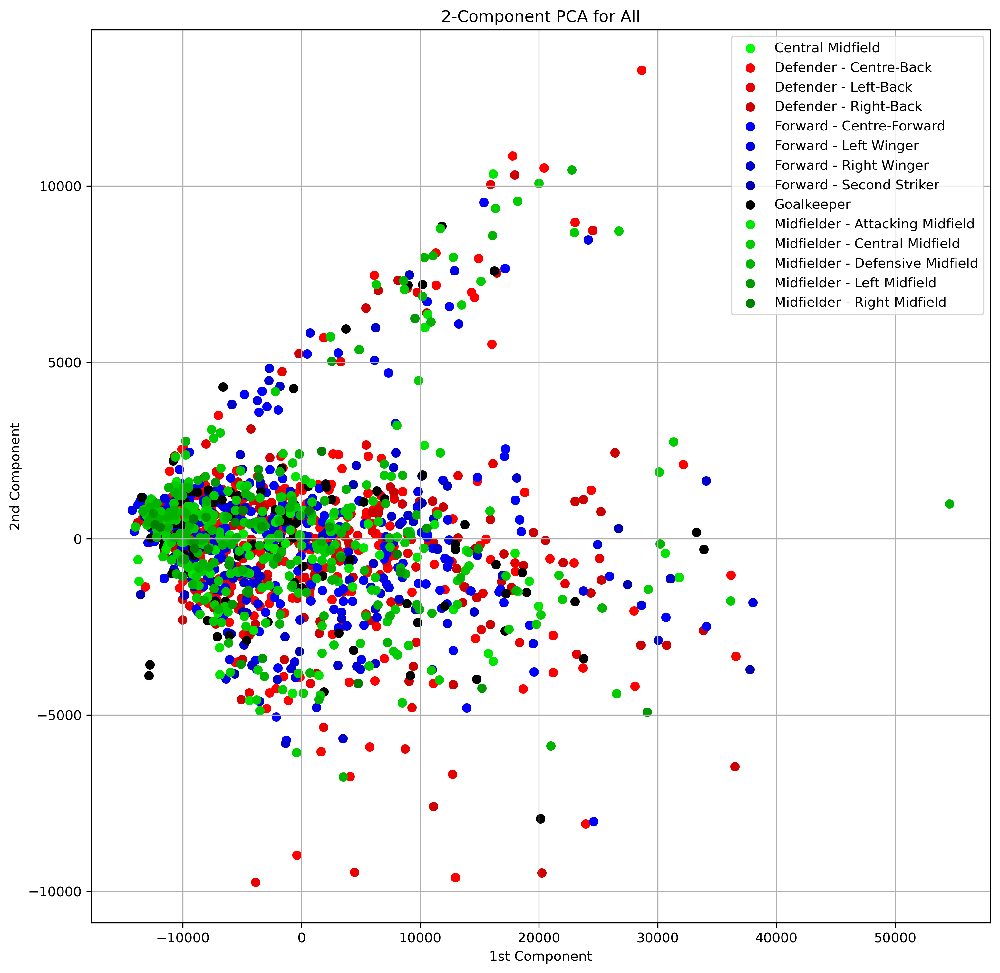

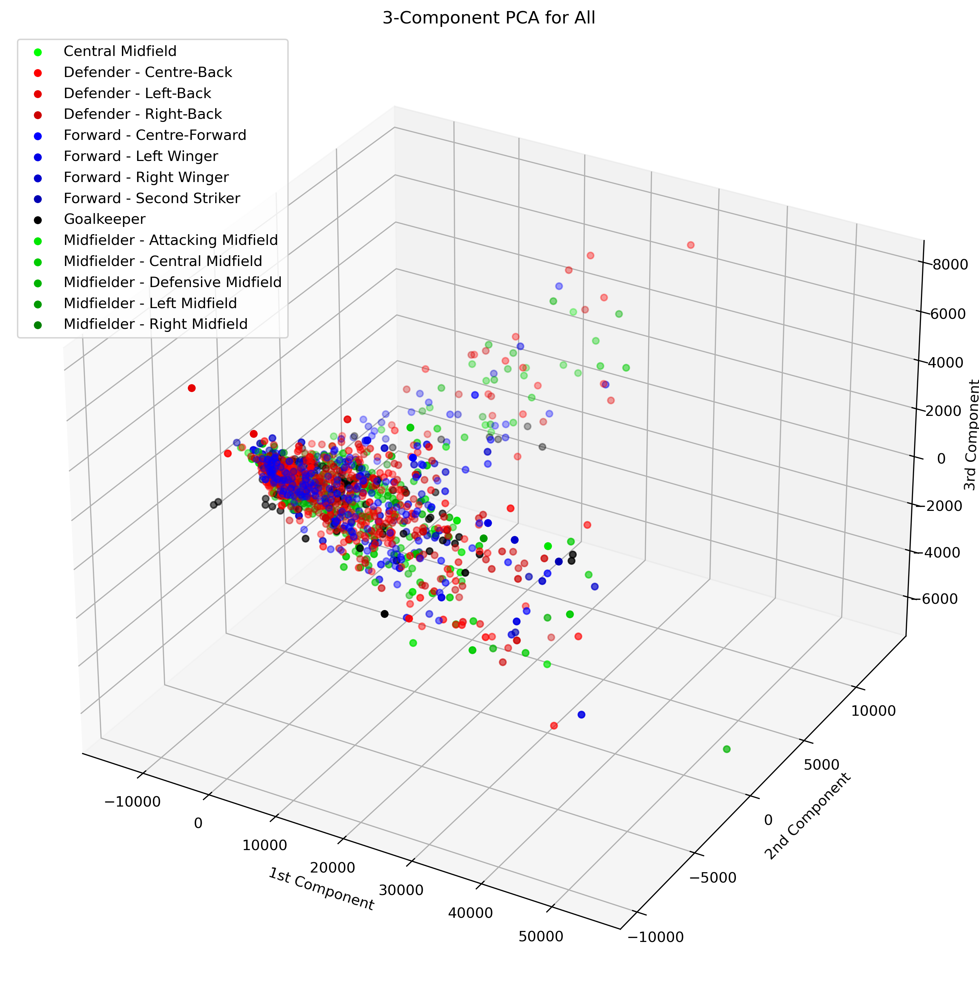

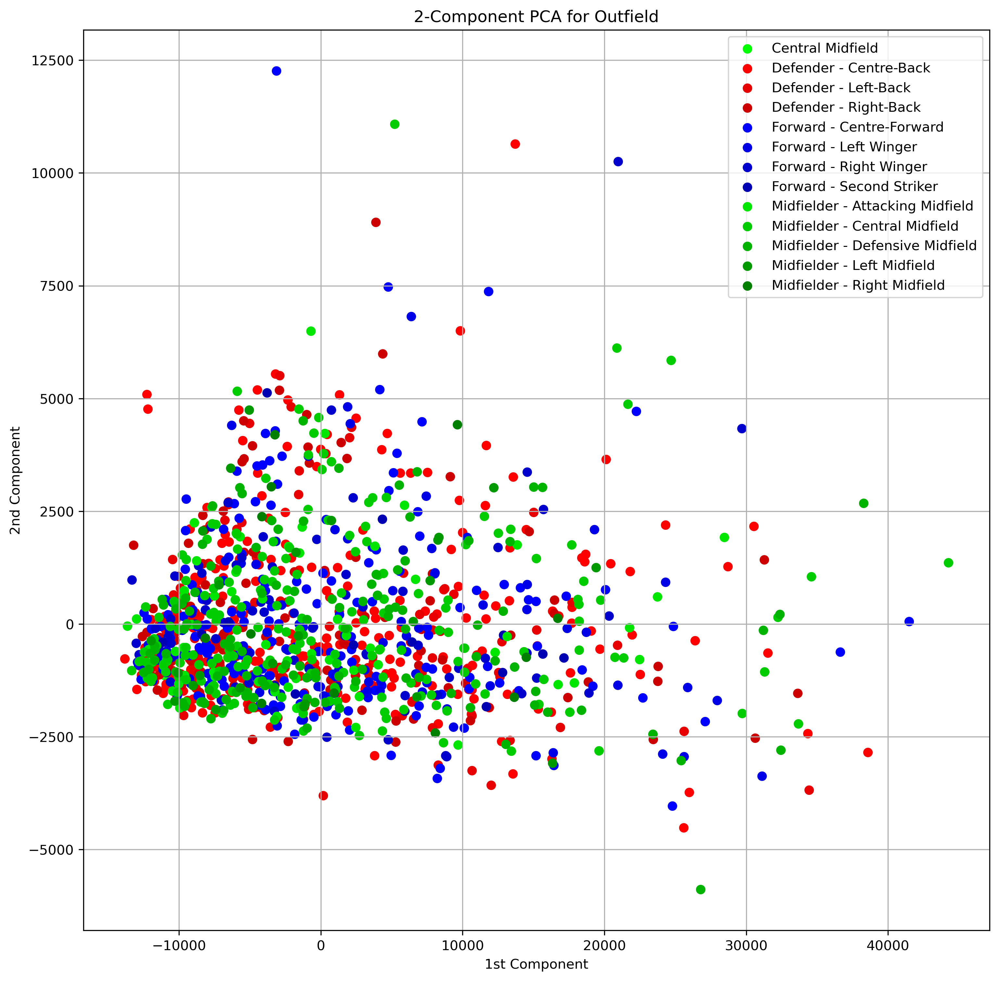

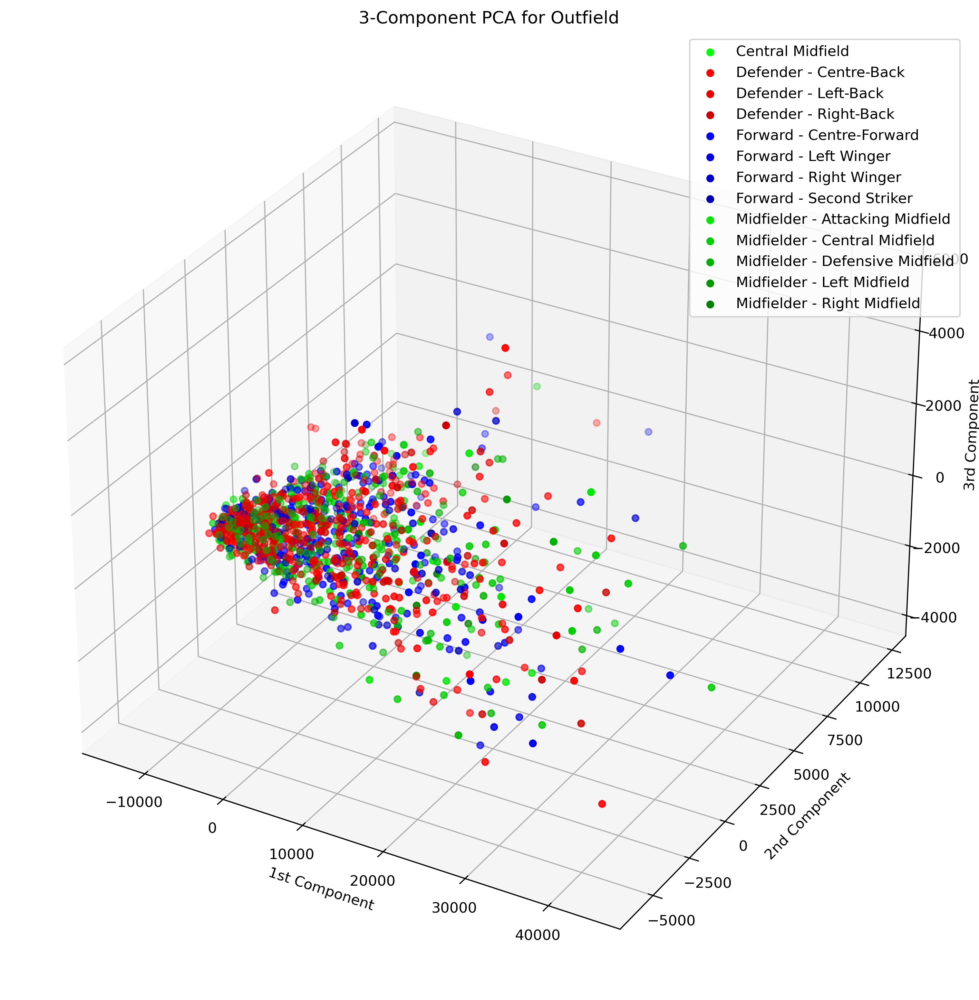

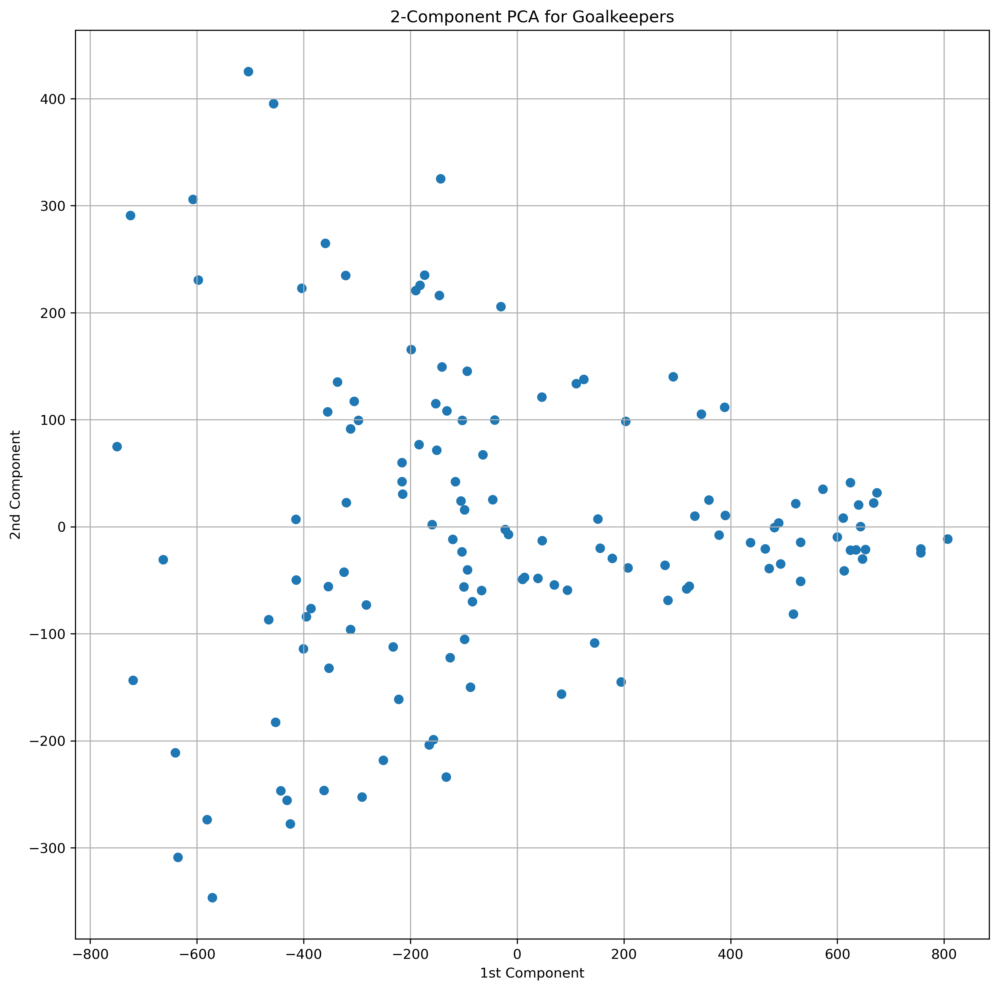

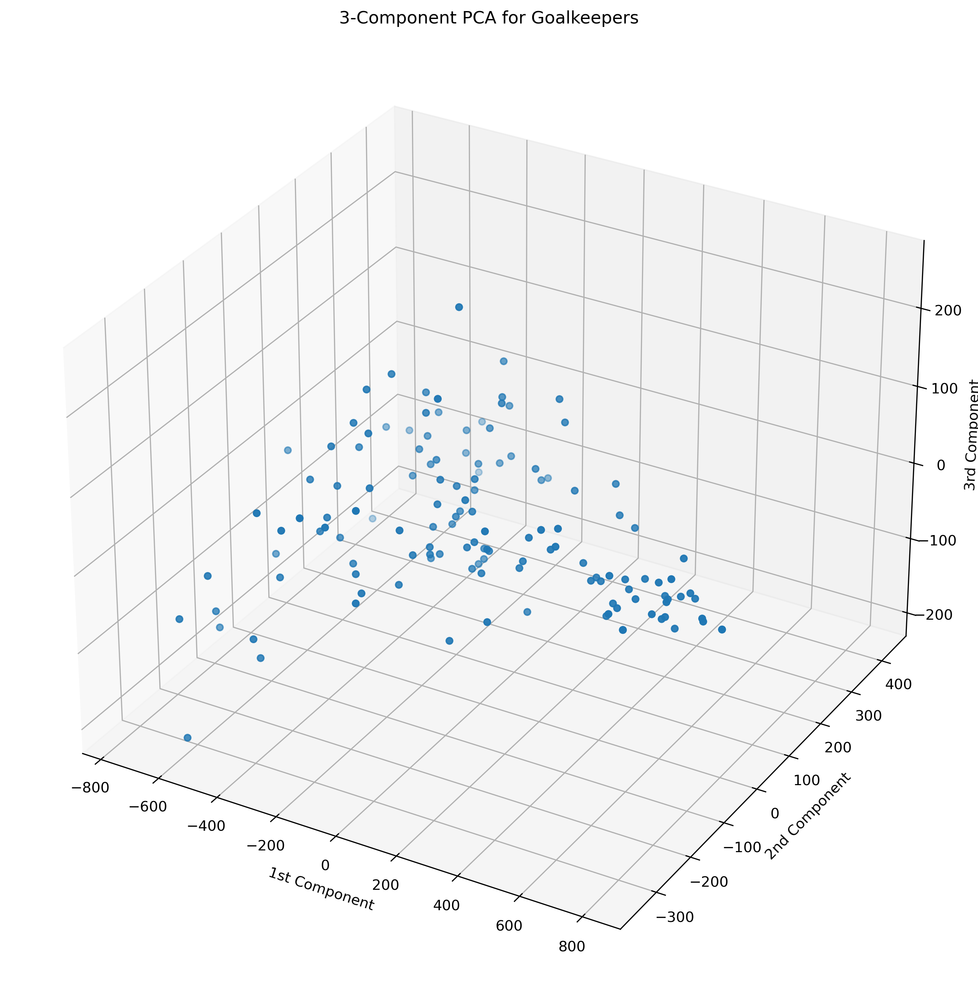

In [11]:
for key in data_dict.keys():
    # 2-D plotting
    temp_df = data_dict[key]['PCA2']['df'].copy()
    temp_df['position'] = data_dict[key]['positions']

    fig = plt.figure(figsize=(12,12), dpi=300)
    axs = fig.add_subplot()

    if key == 'Goalkeepers':
        axs.scatter(temp_df['PCA0'], temp_df['PCA1'])
    else:
        groups = temp_df.groupby('position')
        for name, group in groups:
            if name == 'Goalkeeper':
                axs.scatter(group['PCA0'], group['PCA1'], label=name, color='black')
            else:
                axs.scatter(group['PCA0'], group['PCA1'], label=name, color=next(color_iter))
        axs.legend()
    axs.grid()
    axs.set_xlabel('1st Component')
    axs.set_ylabel('2nd Component')
    axs.set_title('2-Component PCA for {}'.format(key))
    
    # 3-D plotting
    temp_df = data_dict[key]['PCA3']['df'].copy()
    temp_df['position'] = data_dict[key]['positions']

    fig = plt.figure(figsize=(12,12), dpi=300)
    axs = fig.add_subplot(projection='3d')

    if key == 'Goalkeepers':
        axs.scatter(temp_df['PCA0'], temp_df['PCA1'], temp_df['PCA2'])
    else:
        groups = temp_df.groupby('position')
        for name, group in groups:
            if name == 'Goalkeeper':
                axs.scatter(group['PCA0'], group['PCA1'], label=name, color='black')
            else:
                axs.scatter(group['PCA0'], group['PCA1'], group['PCA2'], label=name, color=next(color_iter))
        axs.legend()
    axs.grid()
    axs.set_xlabel('1st Component')
    axs.set_ylabel('2nd Component')
    axs.set_zlabel('3rd Component')
    axs.set_title('3-Component PCA for {}'.format(key))

# Number of Clusters Selection

Determine the correct number of clusters for each model for each set. Each model will be evaluated using a different metric suited to the assumptions and approach of that model. A range of 2 to 20 clusters will be used to train each model.

In [12]:
num_clusters = range(2, 20)

## K-Means
K-Means will be evaluated using the sum of squared difference between each point and the assigned cluster. The 'elbow' method will be used to determine the optimal number of clusters. This is substantiated by there being a diminishing return in cluster assignments when the sum of squared differences ceases decreasing significantly. The 'kneed' algorithm will be used to find the elbow and visual analysis will be performed as to verify the output of the kneed algorithm.

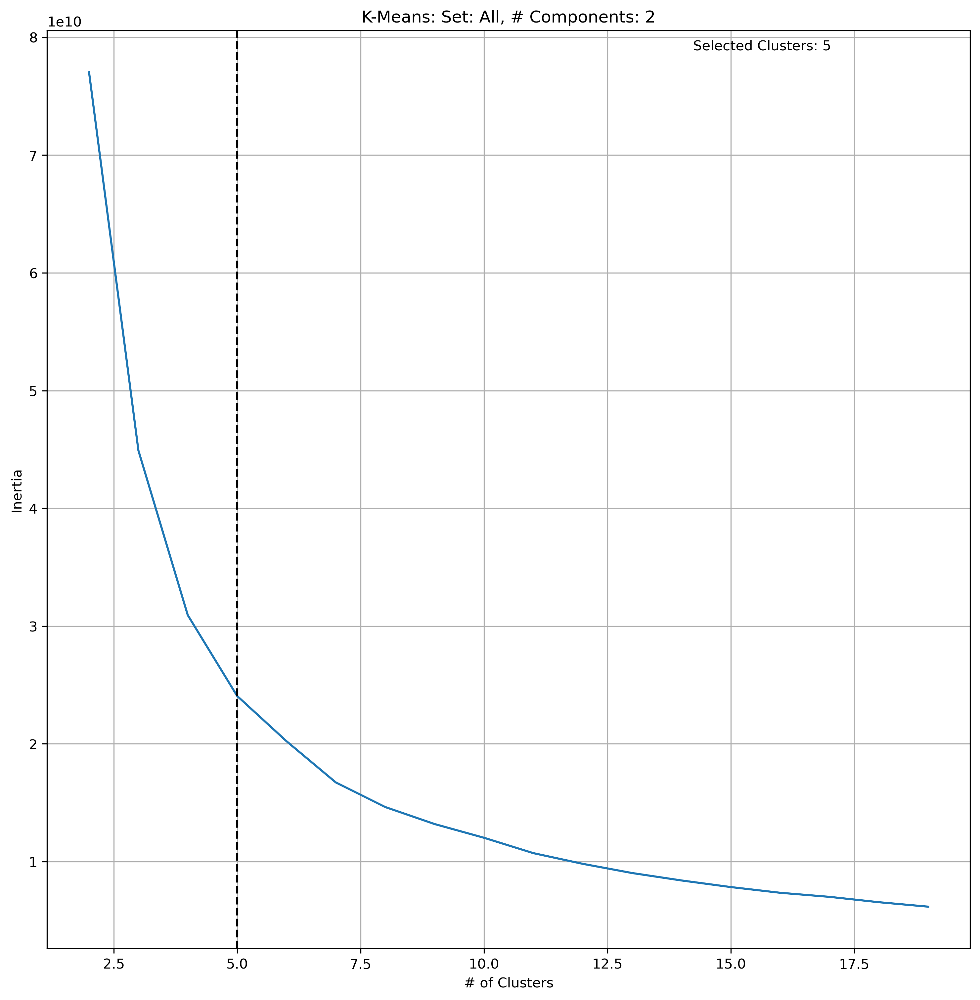

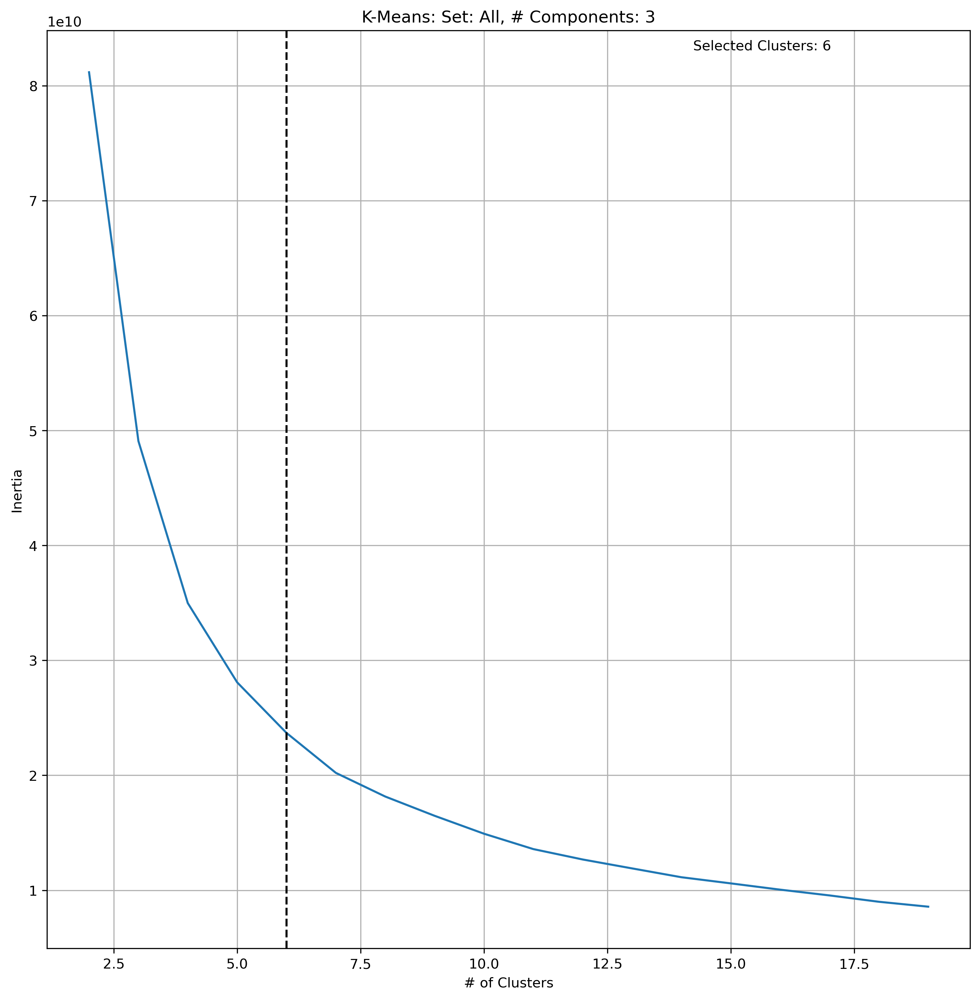

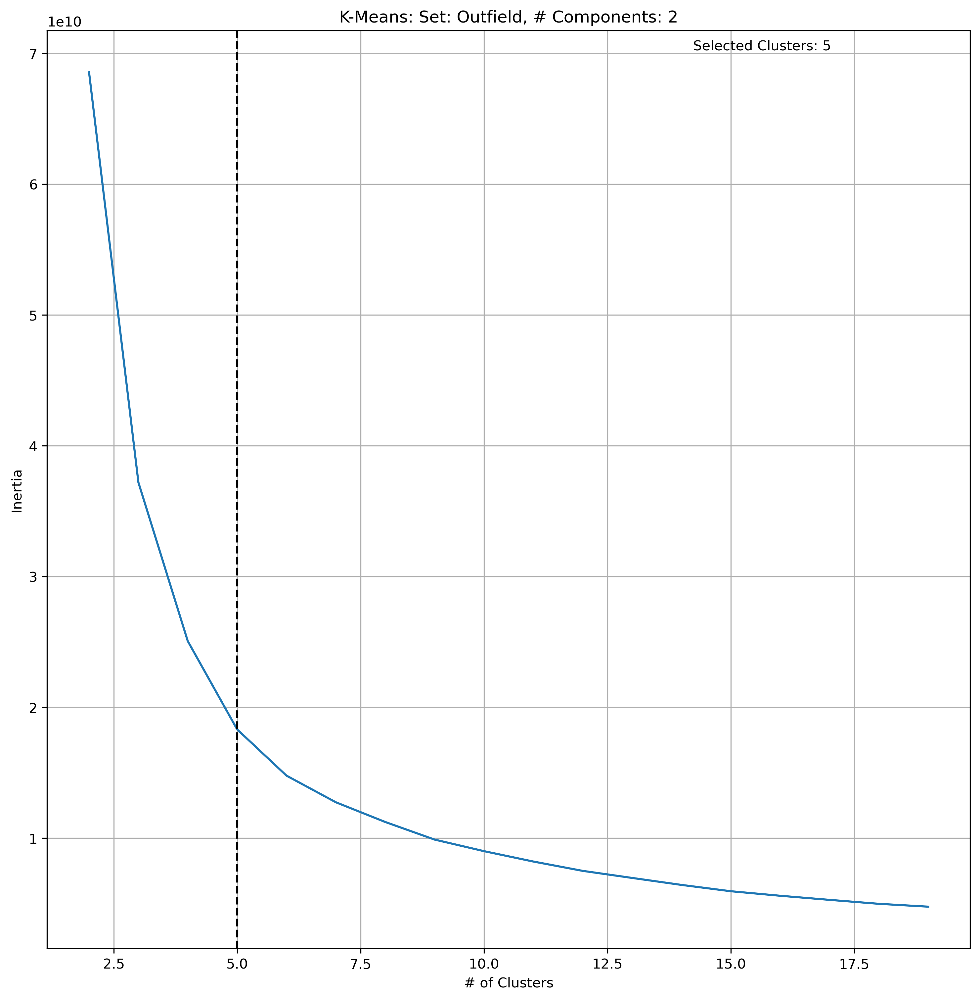

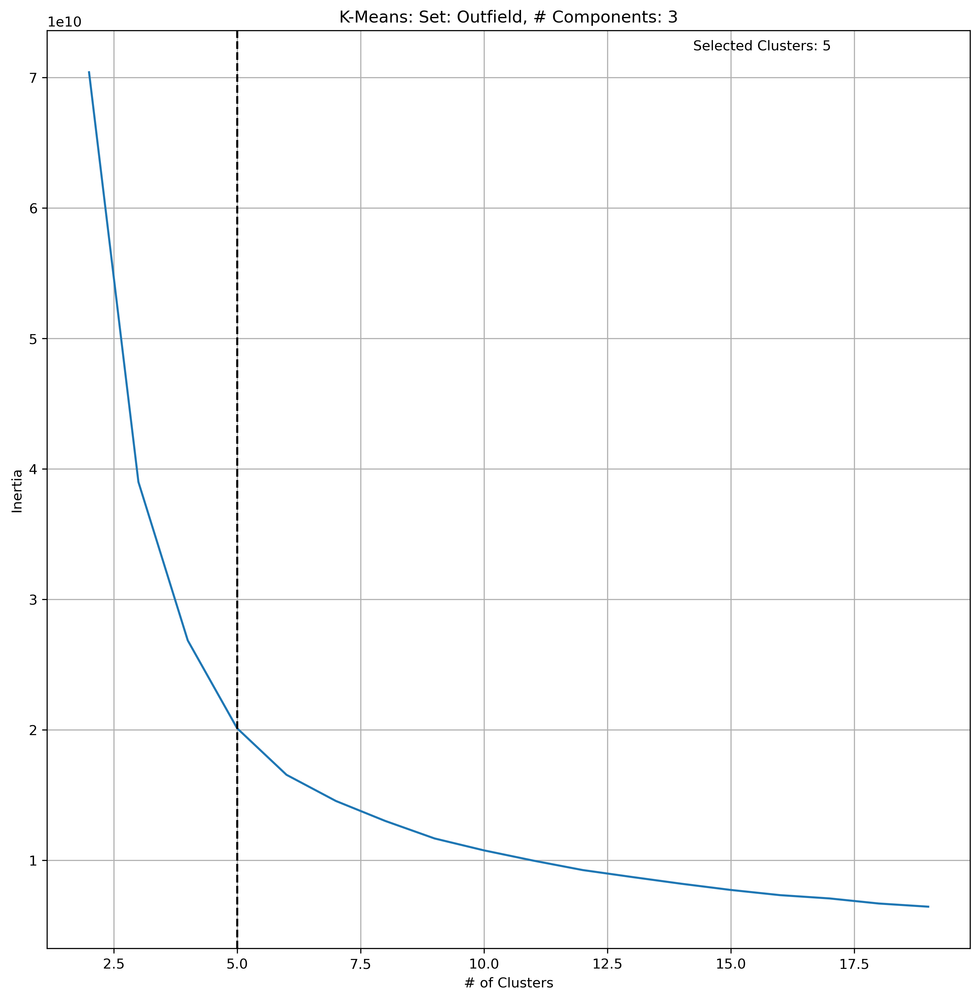

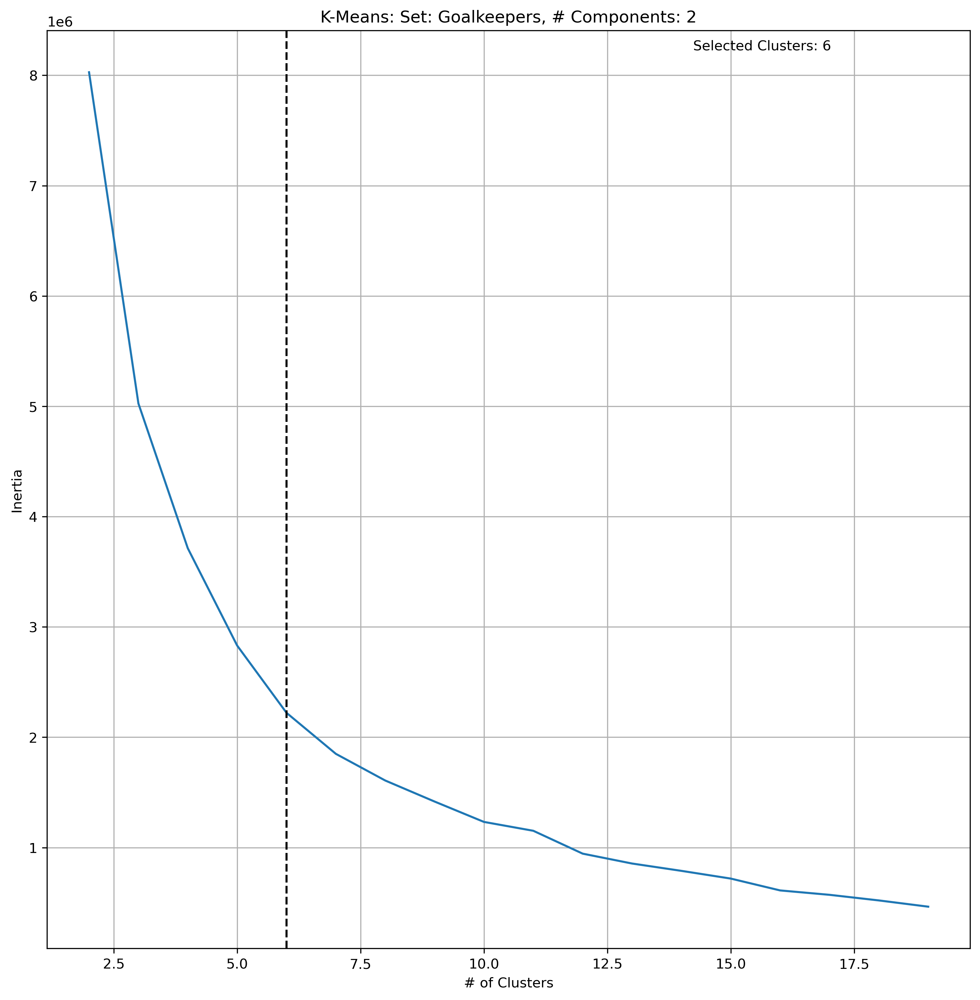

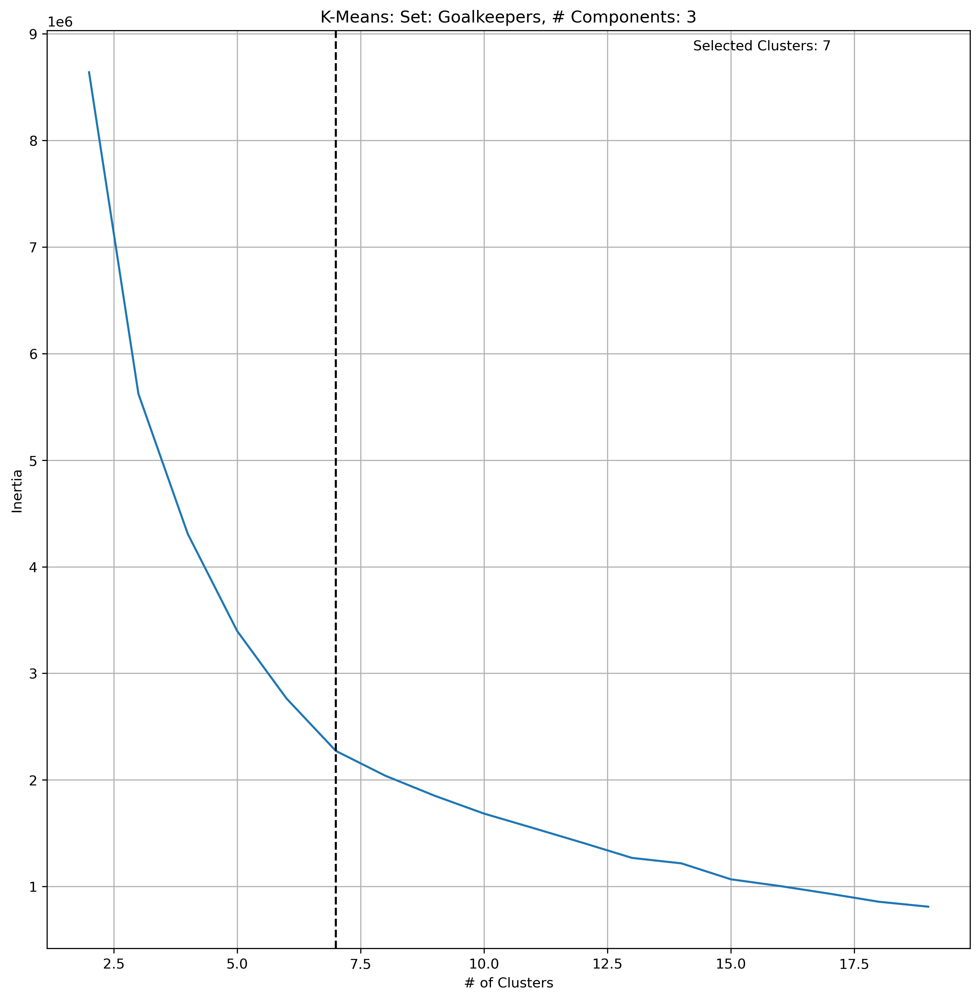

In [13]:
for key in data_dict.keys():
    inertia2 = []
    inertia3 = []
    for k in num_clusters:
        kmeans = KMeans(n_clusters=k)
        inertia2.append(kmeans.fit(data_dict[key]['PCA2']['df']).inertia_)
        inertia3.append(kmeans.fit(data_dict[key]['PCA3']['df']).inertia_)

    kn2 = KneeLocator(num_clusters, inertia2, curve='convex', direction='decreasing')
    kn3 = KneeLocator(num_clusters, inertia3, curve='convex', direction='decreasing')
    
    data_dict[key]['PCA2']['clusters'] = {}
    data_dict[key]['PCA2']['clusters']['k_means'] = kn2.knee
    
    data_dict[key]['PCA3']['clusters'] = {}
    data_dict[key]['PCA3']['clusters']['k_means'] = kn3.knee

    fig = plt.figure(figsize=(12,12), dpi=300)
    axs = fig.add_subplot()
    axs.plot(num_clusters, inertia2)
    axs.axvline(data_dict[key]['PCA2']['clusters']['k_means'], color='black', linestyle='--')
    axs.grid(True)
    axs.set_xlabel('# of Clusters')
    axs.set_ylabel('Inertia')
    axs.set_title('K-Means: Set: {}, # Components: 2'.format(key))
    axs.text(.7, .99, 'Selected Clusters: {}'.format(data_dict[key]['PCA2']['clusters']['k_means']),
             ha='left', va='top', transform=axs.transAxes)
    
    fig = plt.figure(figsize=(12,12), dpi=300)
    axs = fig.add_subplot()
    axs.plot(num_clusters, inertia3)
    axs.axvline(data_dict[key]['PCA3']['clusters']['k_means'], color='black', linestyle='--')
    axs.grid(True)
    axs.set_xlabel('# of Clusters')
    axs.set_ylabel('Inertia')
    axs.set_title('K-Means: Set: {}, # Components: 3'.format(key))
    axs.text(.7, .99, 'Selected Clusters: {}'.format(data_dict[key]['PCA3']['clusters']['k_means']),
             ha='left', va='top', transform=axs.transAxes)

## Gaussian Mixture Model
The number of clusters to use for the Gaussian Mixture Model (GMM) will be assessed again using the kneed algorithm, but with the Akaike Information Criteria (AIC) rather than the sum of squared differences. AIC is a more appropriate choice for GMM since GMM relies on an underlying maximum likelihood estimation (MLE). Furthermore sum of squared differences relies on a discrete assignment to a cluster, which is not true of GMM.

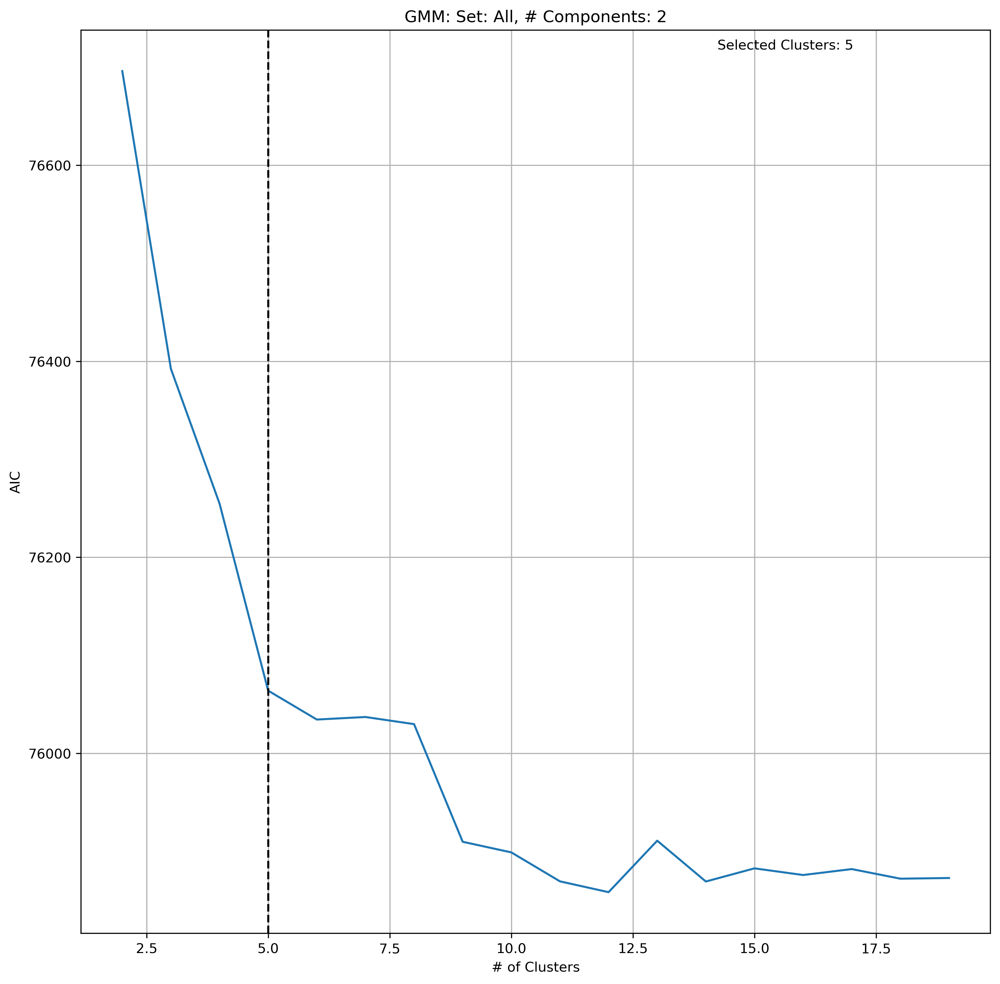

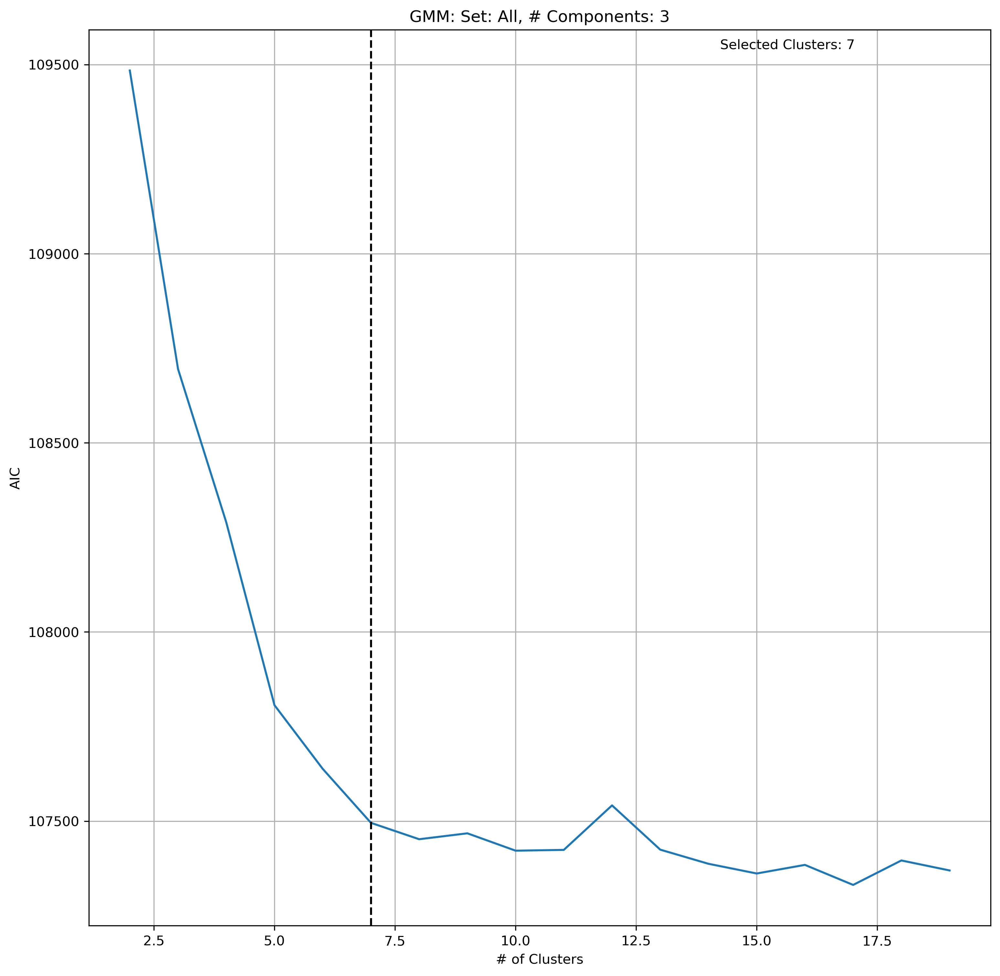

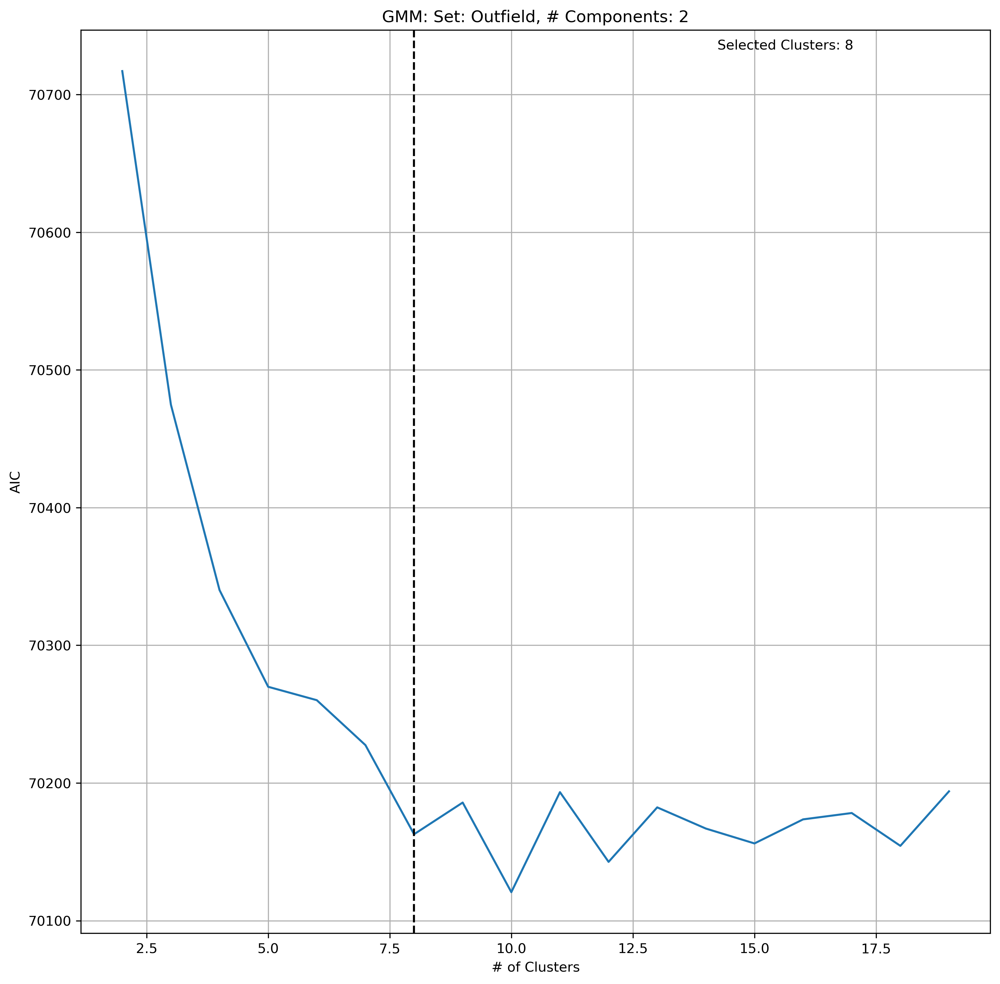

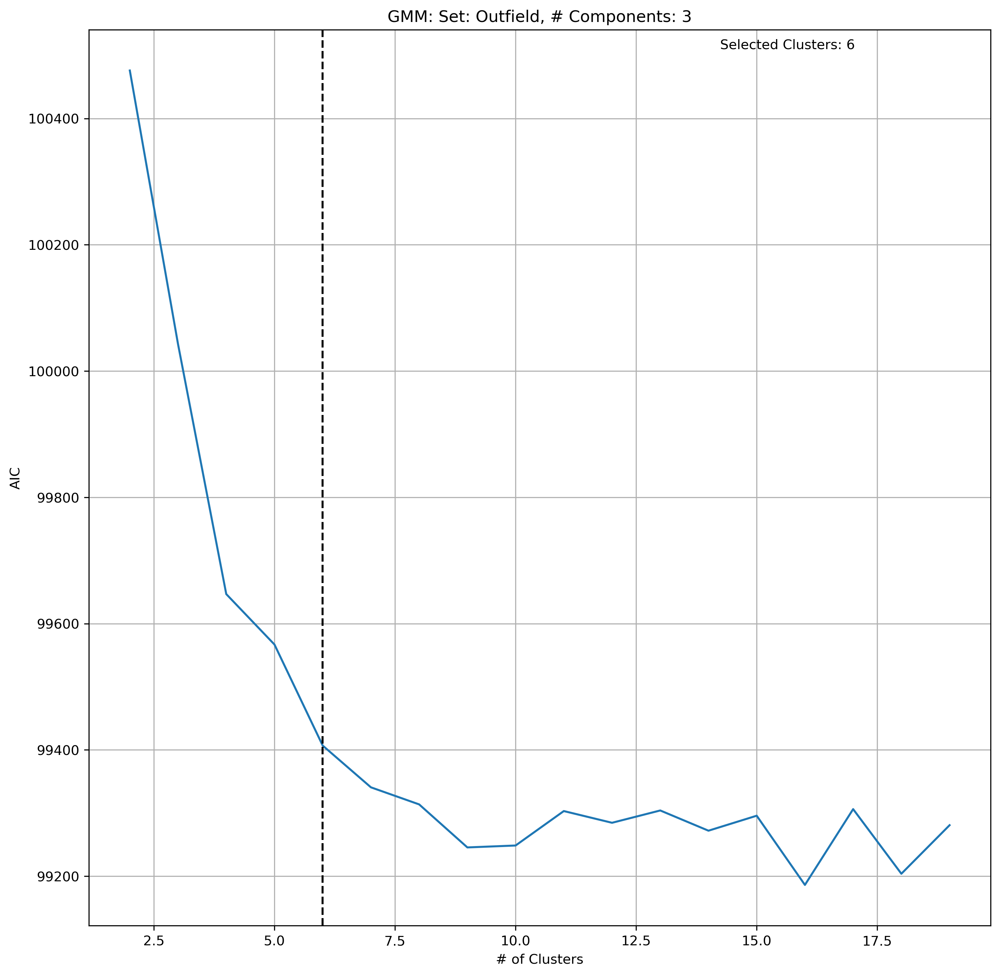

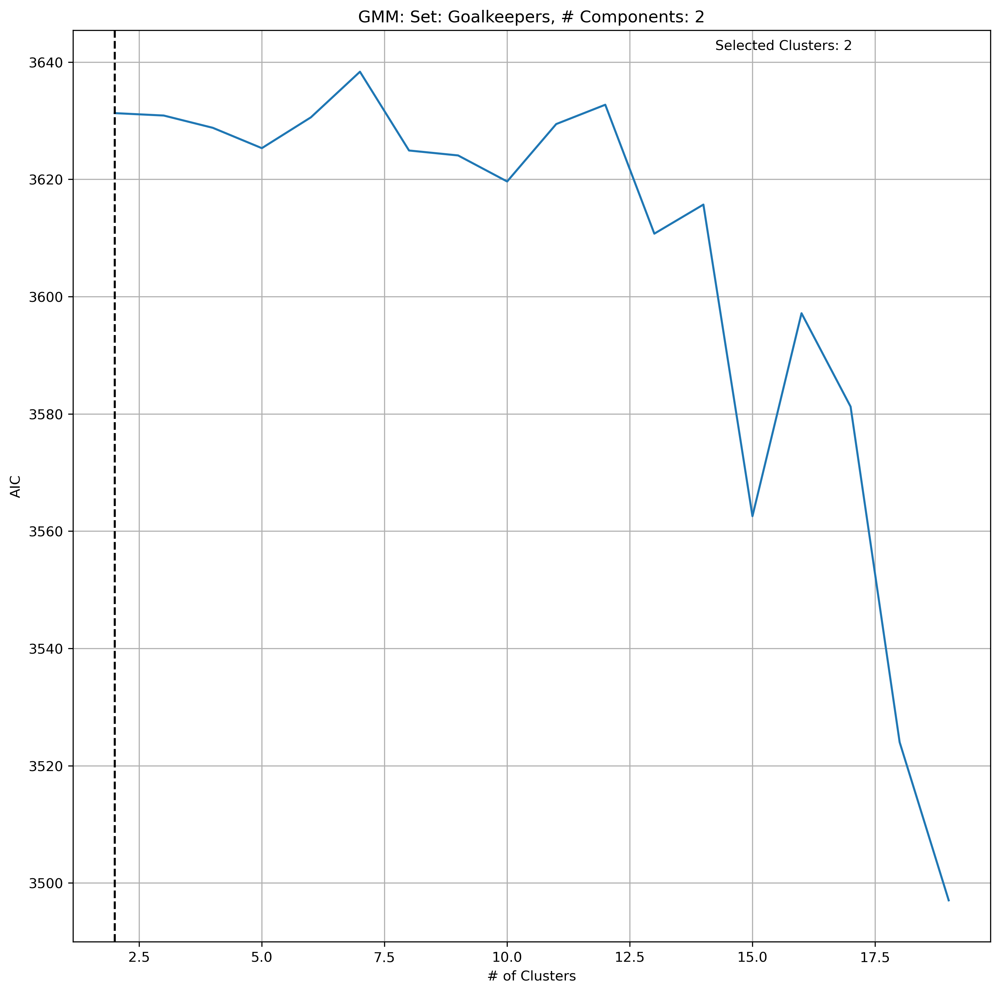

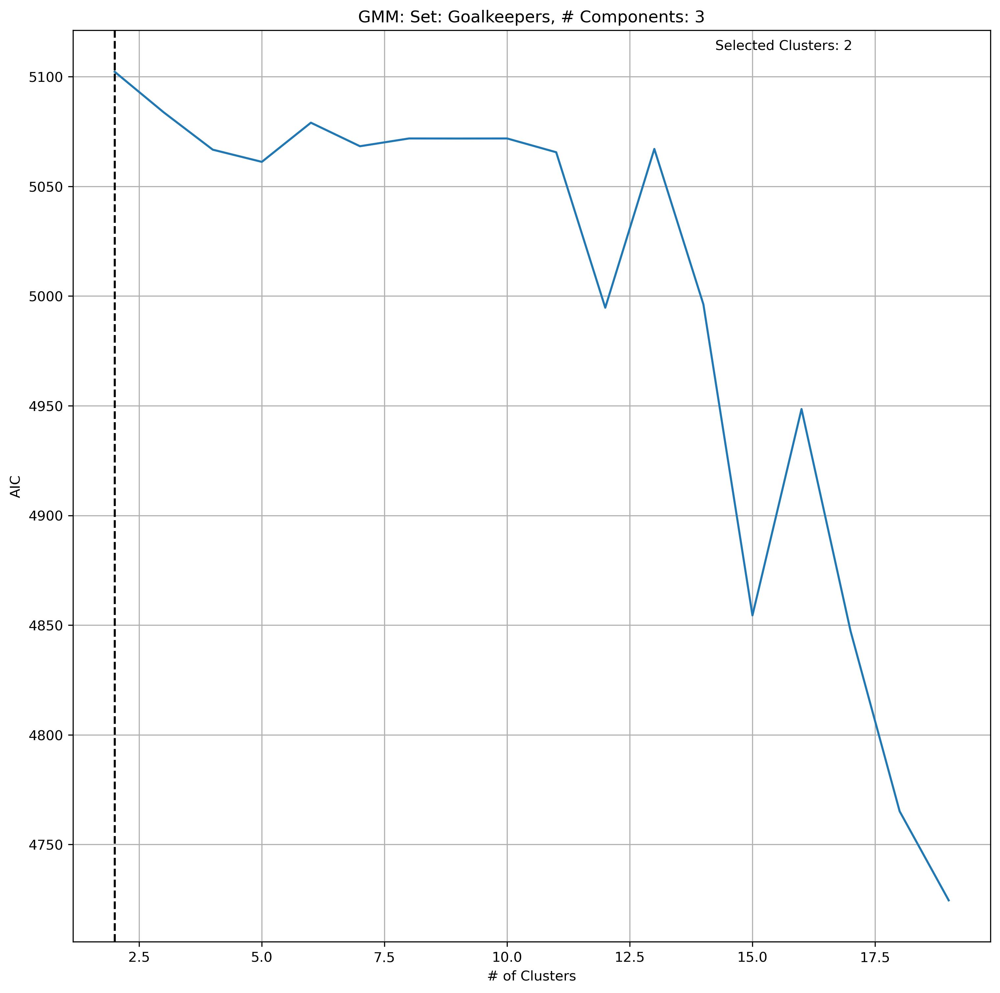

In [14]:
for key in data_dict.keys():
    aic2 = []
    aic3 = []
    for k in num_clusters:
        gmm = GaussianMixture(n_components=k)
        aic2.append(gmm.fit(data_dict[key]['PCA2']['df']).aic(data_dict[key]['PCA2']['df']))
        aic3.append(gmm.fit(data_dict[key]['PCA3']['df']).aic(data_dict[key]['PCA3']['df']))

    kn2 = KneeLocator(num_clusters, aic2, curve='convex', direction='decreasing')
    kn3 = KneeLocator(num_clusters, aic3, curve='convex', direction='decreasing')
    
    data_dict[key]['PCA2']['clusters']['gmm'] = kn2.knee
    data_dict[key]['PCA3']['clusters']['gmm'] = kn3.knee

    fig = plt.figure(figsize=(12,12), dpi=300)
    axs = fig.add_subplot()
    axs.plot(num_clusters, aic2)
    axs.axvline(data_dict[key]['PCA2']['clusters']['gmm'], color='black', linestyle='--')
    axs.grid(True)
    axs.set_xlabel('# of Clusters')
    axs.set_ylabel('AIC')
    axs.set_title('GMM: Set: {}, # Components: 2'.format(key))
    axs.text(.7, .99, 'Selected Clusters: {}'.format(data_dict[key]['PCA2']['clusters']['gmm']),
             ha='left', va='top', transform=axs.transAxes)
    
    fig = plt.figure(figsize=(12,12), dpi=300)
    axs = fig.add_subplot()
    axs.plot(num_clusters, aic3)
    axs.axvline(data_dict[key]['PCA3']['clusters']['gmm'], color='black', linestyle='--')
    axs.grid(True)
    axs.set_xlabel('# of Clusters')
    axs.set_ylabel('AIC')
    axs.set_title('GMM: Set: {}, # Components: 3'.format(key))
    axs.text(.7, .99, 'Selected Clusters: {}'.format(data_dict[key]['PCA3']['clusters']['gmm']),
             ha='left', va='top', transform=axs.transAxes)

## Spectral Clustering
The number of clusters to use for the Spectral Clustering algorithm will again be selected using the Kneed algorithm. However, the algorithm will be run on the 'eigengaps' of the eigenvalues of the Laplacian formed in calculating the Spectral Clustering soltuion.

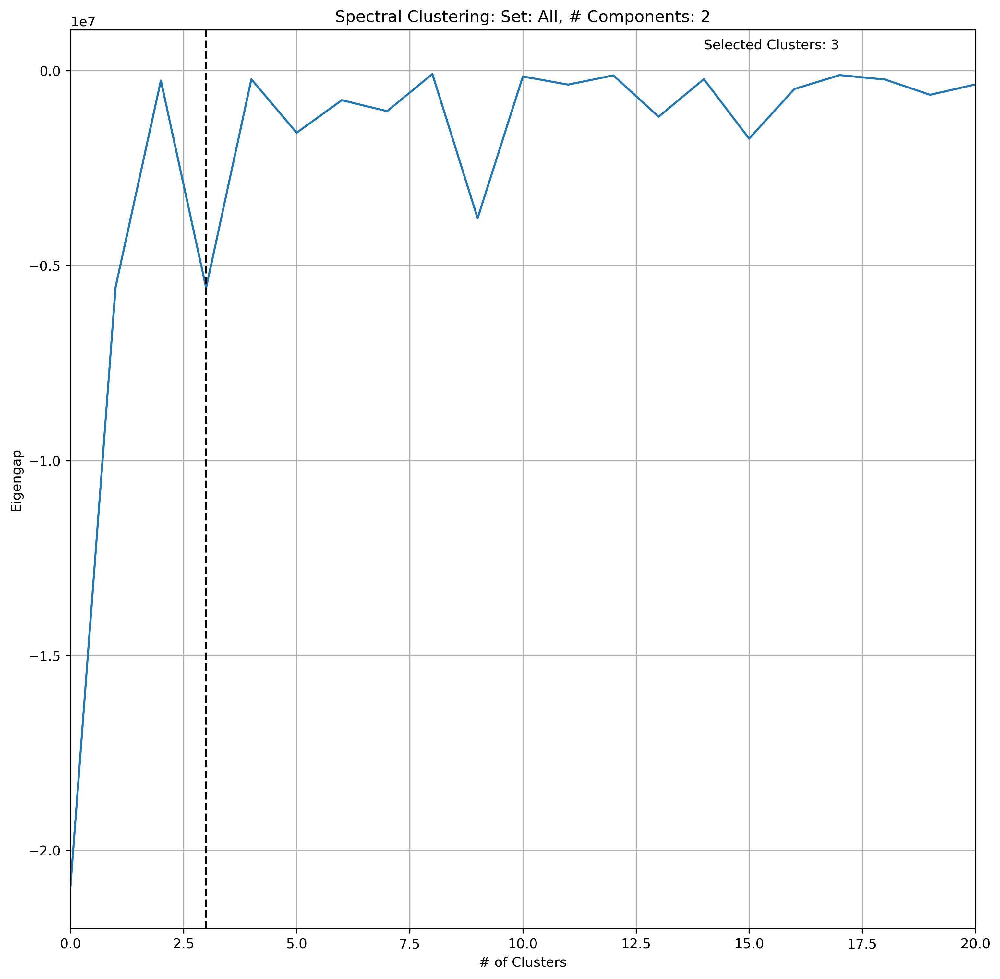

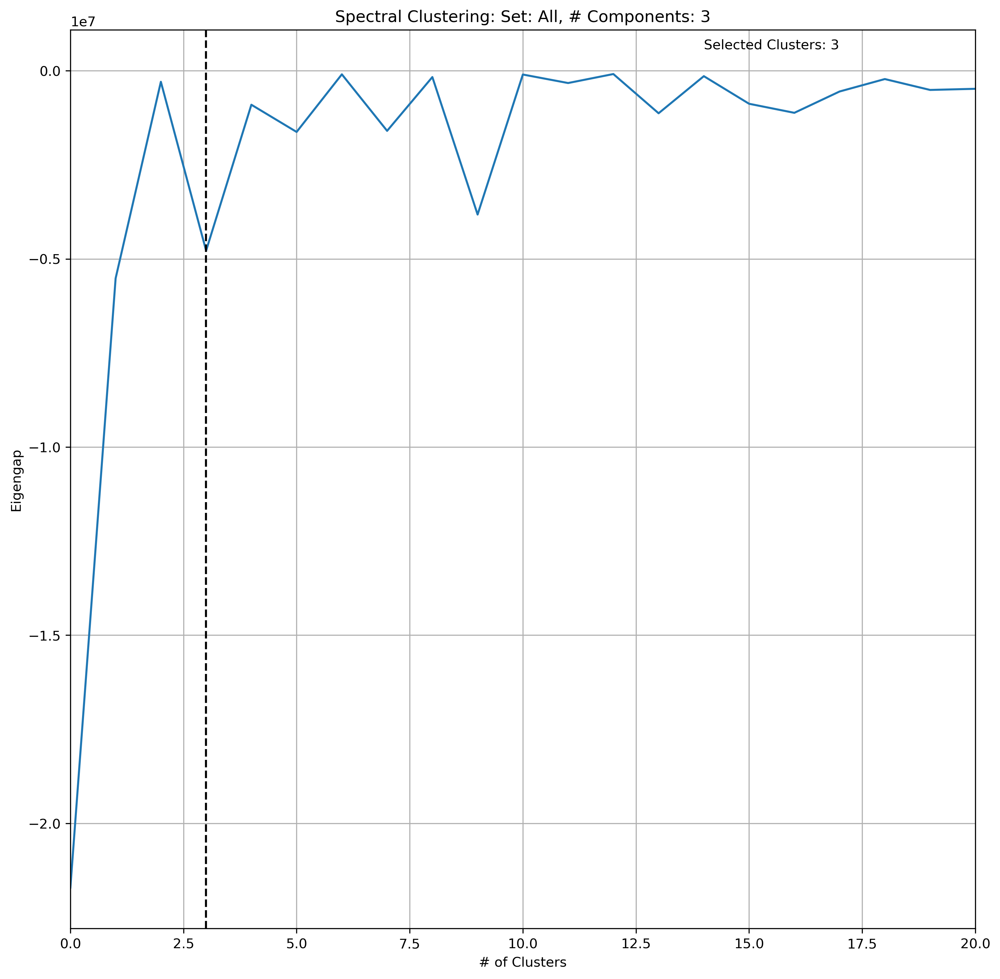

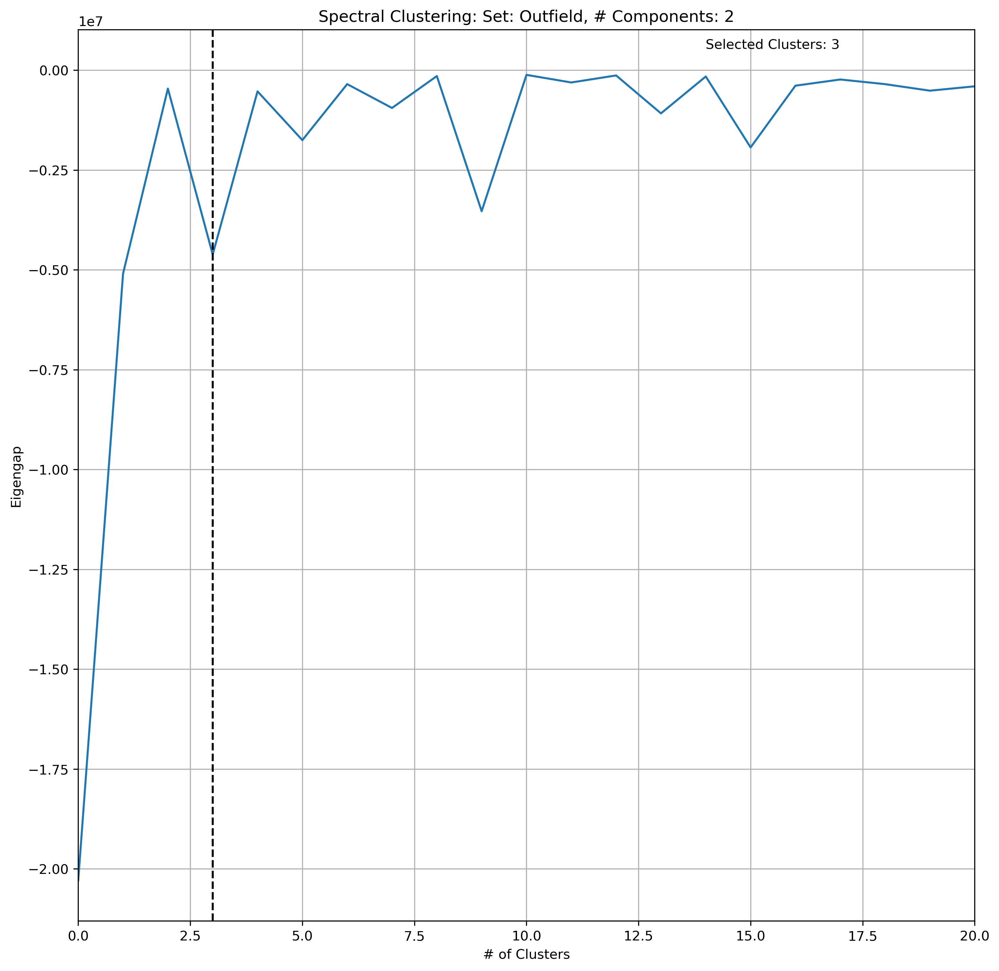

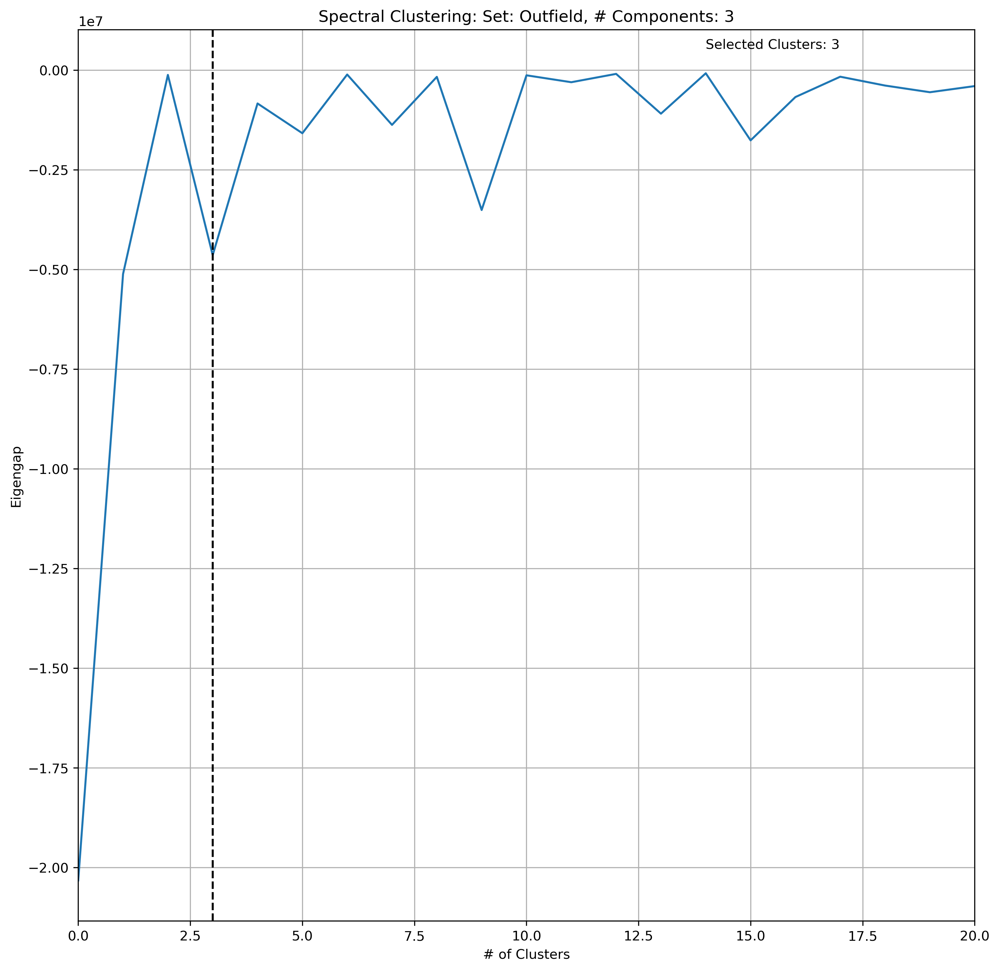

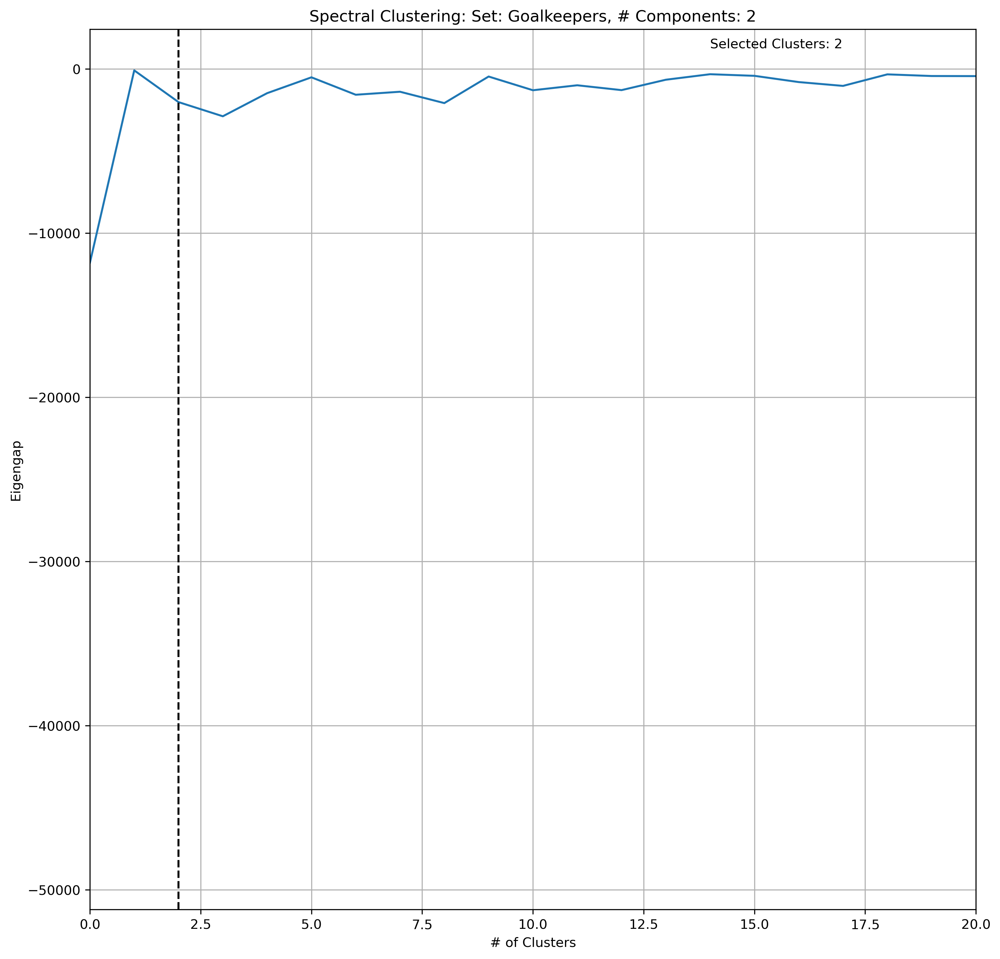

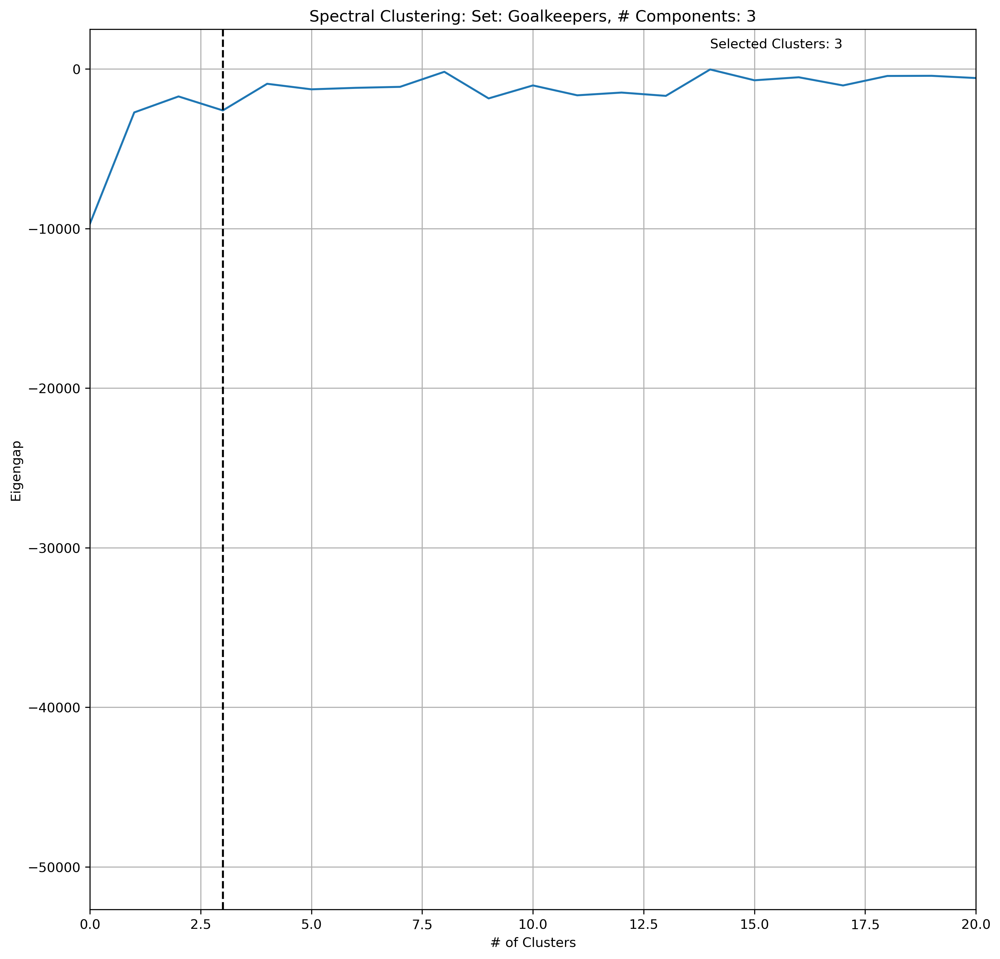

In [15]:
for key in data_dict.keys():
    A = pairwise_distances(data_dict[key]['PCA2']['df'])
    D = np.diag(np.sum(A, axis=1))
    L = D - A
    lambd, _ = np.linalg.eig(L)
    lambd = sorted(lambd, reverse=True)

    eigengaps2 = []
    for i in range(1, len(lambd)):
        eigengaps2.append(lambd[i]-lambd[i-1])
    kn = KneeLocator(range(1, len(lambd)), eigengaps2, curve='concave', direction='increasing')

    data_dict[key]['PCA2']['clusters']['sc'] = kn.knee
    
    A = pairwise_distances(data_dict[key]['PCA3']['df'])
    D = np.diag(np.sum(A, axis=1))
    L = D - A
    lambd, _ = np.linalg.eig(L)
    lambd = sorted(lambd, reverse=True)

    eigengaps3 = []
    for i in range(1, len(lambd)):
        eigengaps3.append(lambd[i]-lambd[i-1])
    kn = KneeLocator(range(1, len(lambd)), eigengaps3, curve='concave', direction='increasing')

    data_dict[key]['PCA3']['clusters']['sc'] = kn.knee

    fig = plt.figure(figsize=(12,12), dpi=300)
    axs = fig.add_subplot()
    axs.plot(range(len(eigengaps2)), eigengaps2)
    axs.set_xlim([0, 20])
    axs.axvline(data_dict[key]['PCA2']['clusters']['sc'], color='black', linestyle='--')
    axs.grid(True)
    axs.set_xlabel('# of Clusters')
    axs.set_ylabel('Eigengap')
    axs.set_title('Spectral Clustering: Set: {}, # Components: {}'.format(key, 2))
    axs.text(.7, .99, 'Selected Clusters: {}'.format(data_dict[key]['PCA2']['clusters']['sc']),
             ha='left', va='top', transform=axs.transAxes)

    fig = plt.figure(figsize=(12,12), dpi=300)
    axs = fig.add_subplot()
    axs.plot(range(len(eigengaps3)), eigengaps3)
    axs.set_xlim([0, 20])
    axs.axvline(data_dict[key]['PCA3']['clusters']['sc'], color='black', linestyle='--')
    axs.grid(True)
    axs.set_xlabel('# of Clusters')
    axs.set_ylabel('Eigengap')
    axs.set_title('Spectral Clustering: Set: {}, # Components: {}'.format(key, 3))
    axs.text(.7, .99, 'Selected Clusters: {}'.format(data_dict[key]['PCA3']['clusters']['sc']),
             ha='left', va='top', transform=axs.transAxes)

# Plotting of Resulting Models

## K-Means

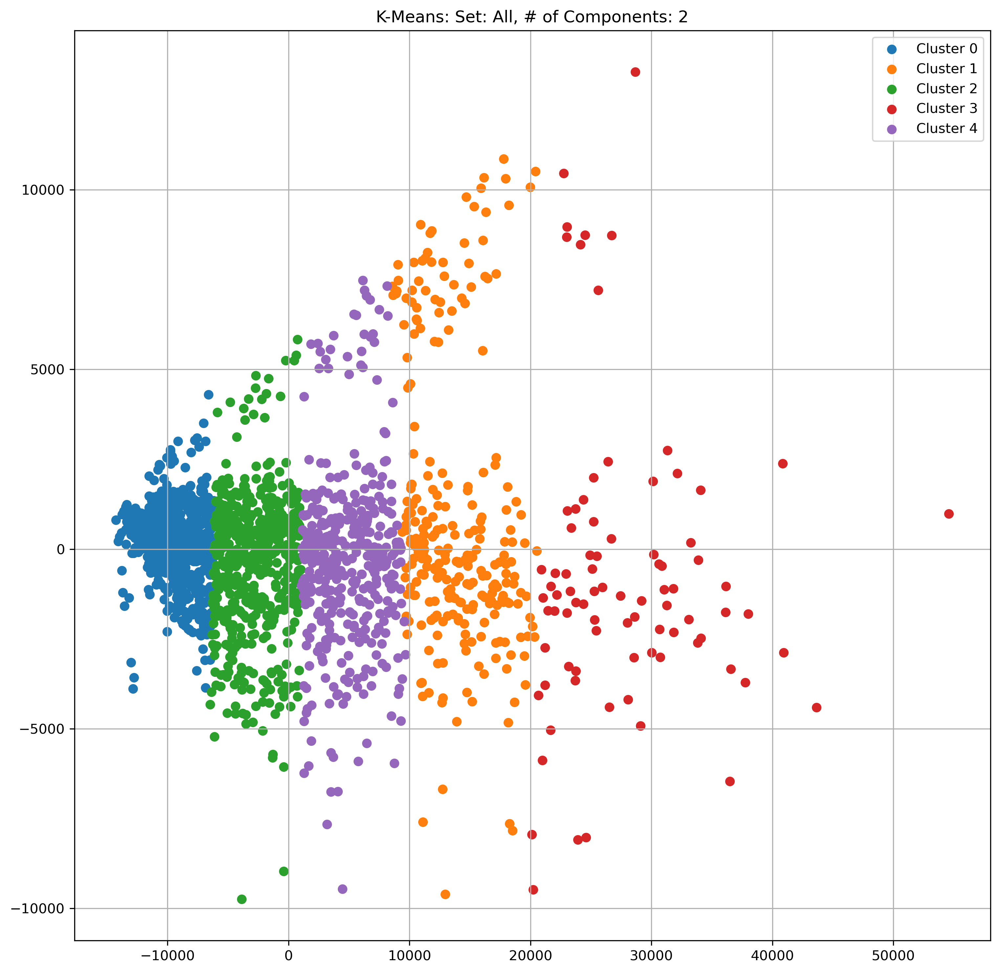

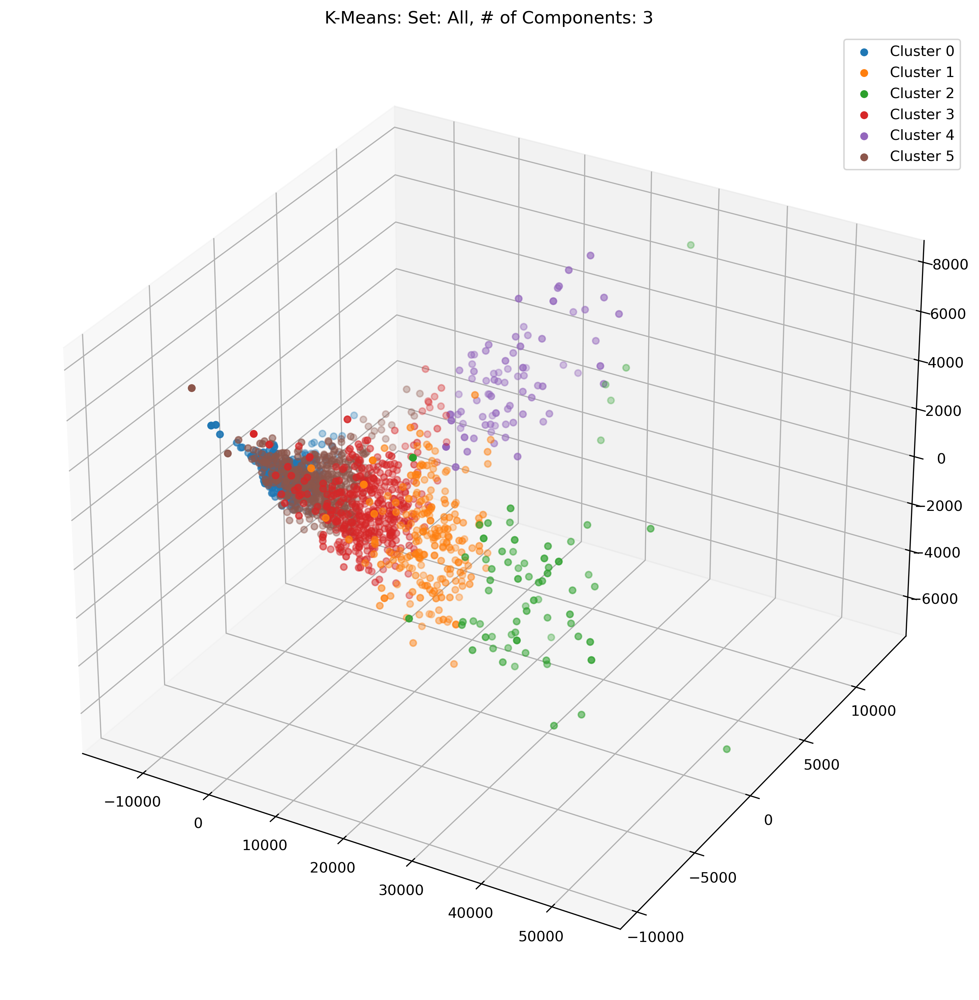

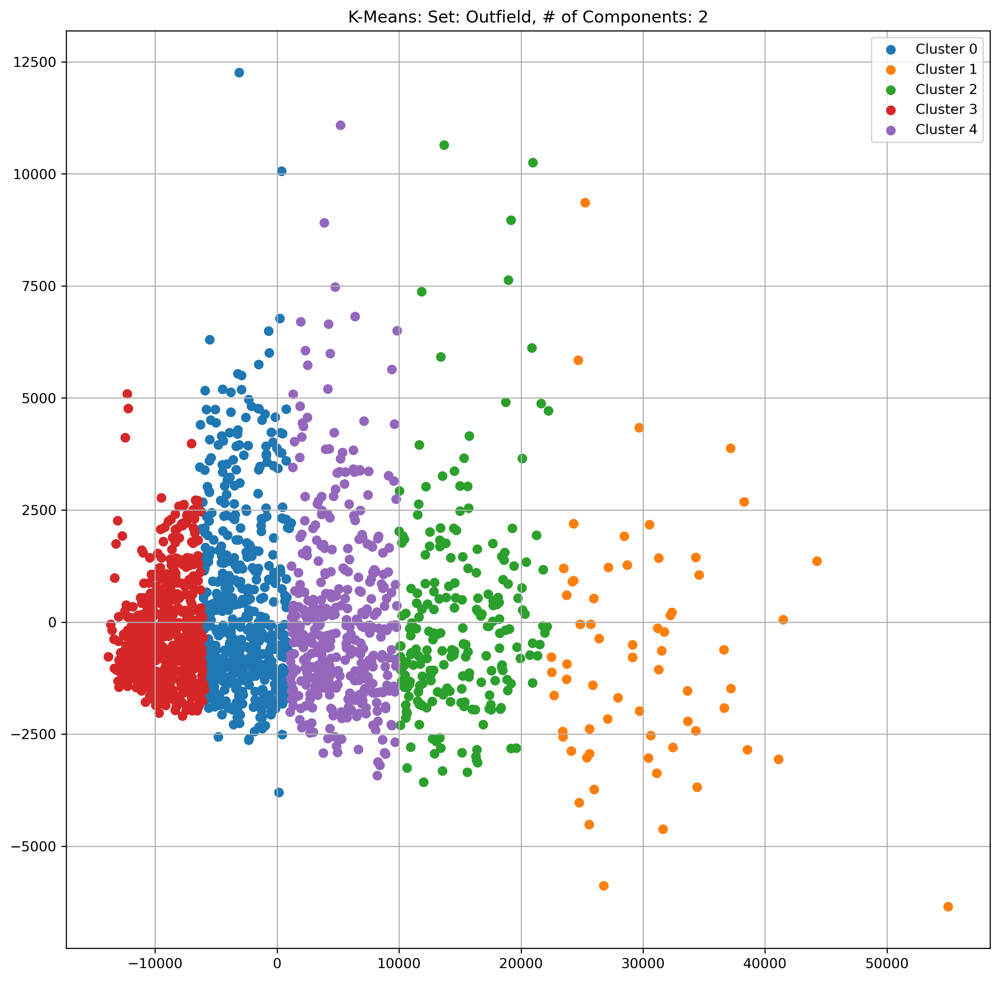

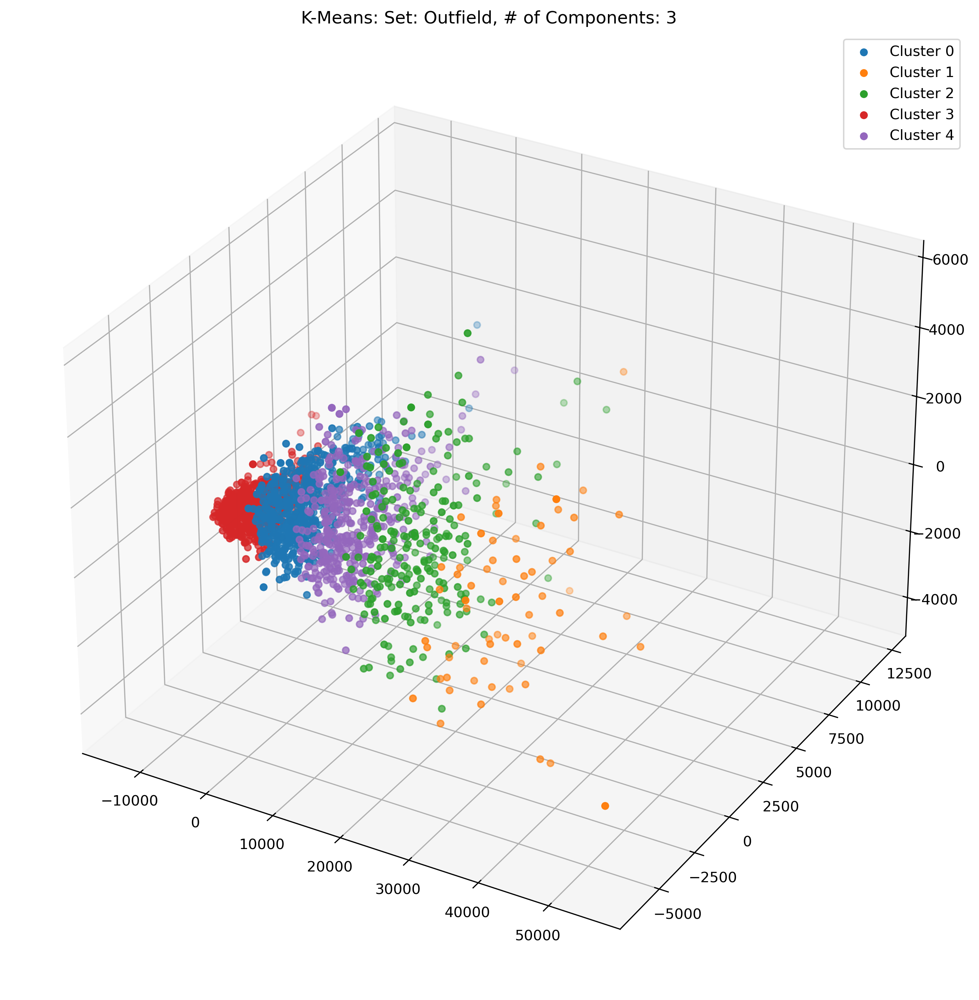

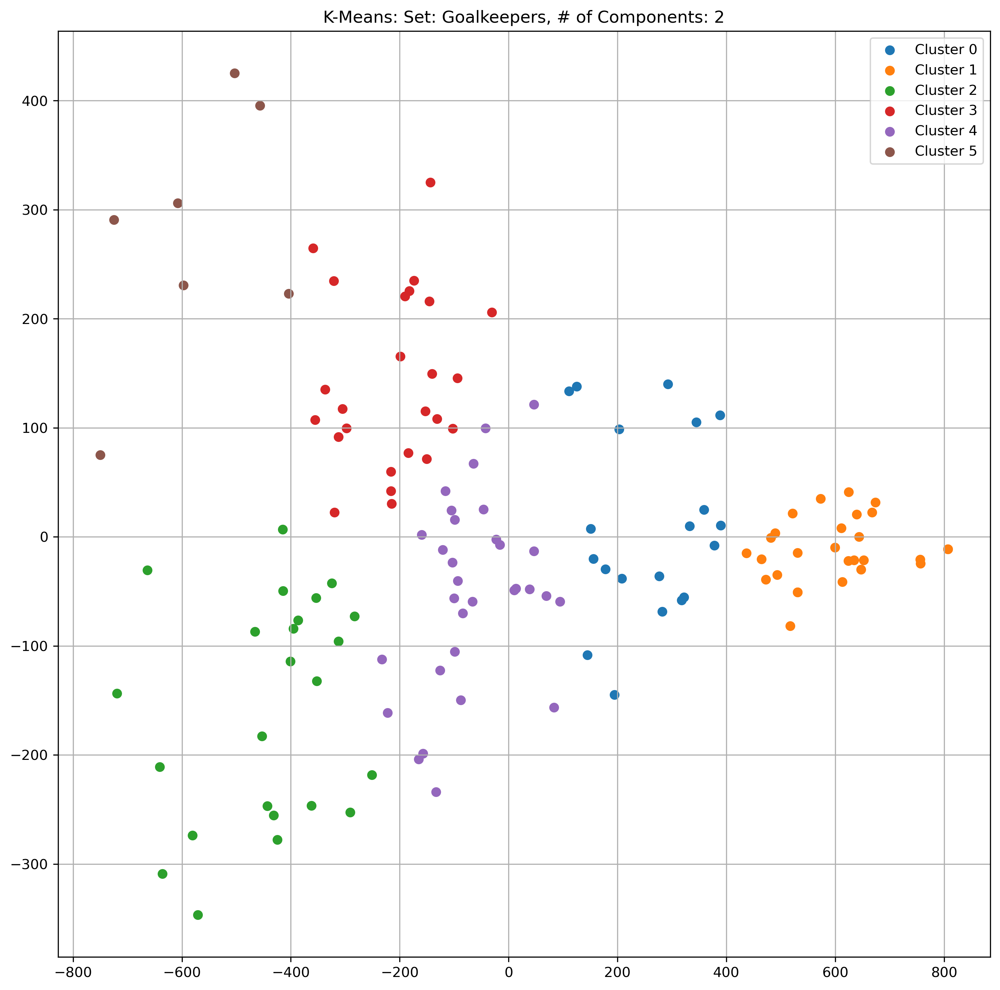

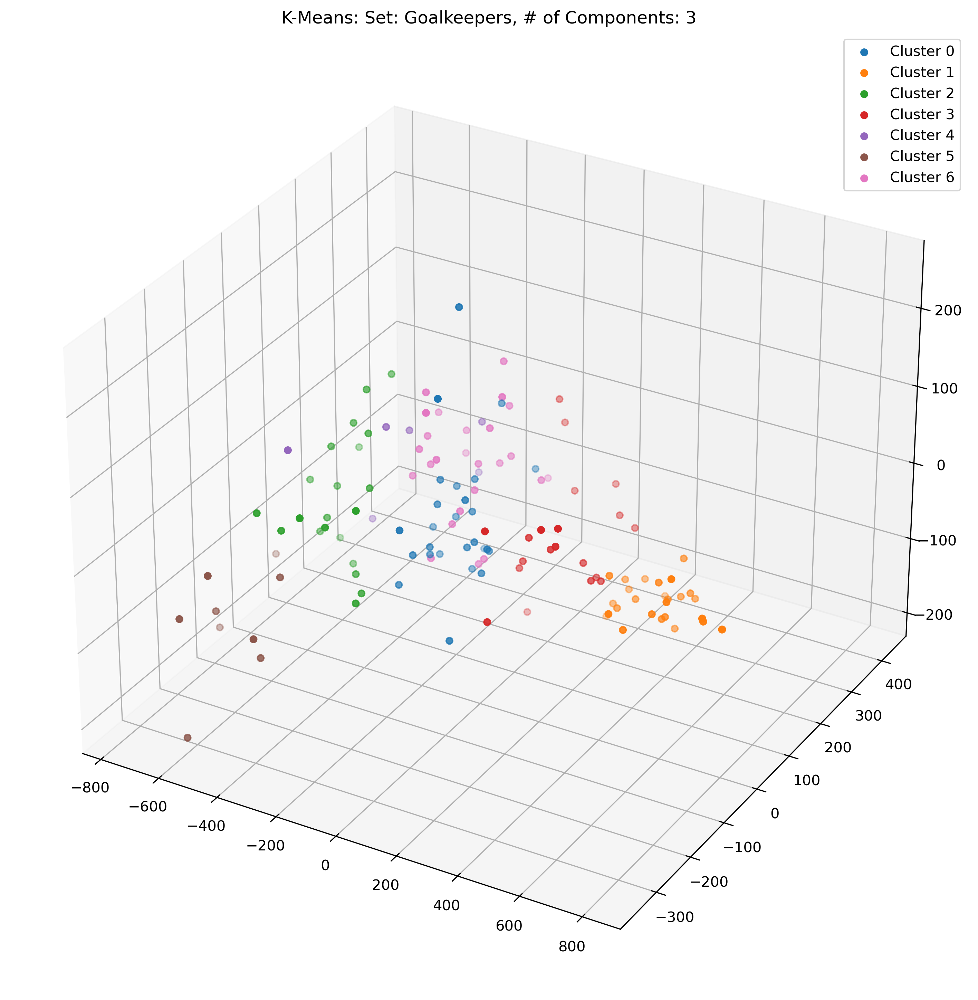

In [16]:
for key in data_dict.keys():

    kmeans2 = KMeans(n_clusters=data_dict[key]['PCA2']['clusters']['k_means']).fit(data_dict[key]['PCA2']['df'])
    kmeans3 = KMeans(n_clusters=data_dict[key]['PCA3']['clusters']['k_means']).fit(data_dict[key]['PCA3']['df'])
    
    data_dict[key]['PCA2']['labels'] = {}
    data_dict[key]['PCA3']['labels'] = {}
    data_dict[key]['PCA2']['labels']['k_means'] = kmeans2.labels_
    data_dict[key]['PCA3']['labels']['k_means'] = kmeans3.labels_

    temp_df = data_dict[key]['PCA2']['df'].copy()
    temp_df['label'] = data_dict[key]['PCA2']['labels']['k_means']
    groups = temp_df.groupby('label')
    
    fig = plt.figure(figsize=(12,12), dpi=300)
    axs = fig.add_subplot()
    for name, group in groups:
        axs.scatter(group['PCA0'], group['PCA1'], label='Cluster {}'.format(name))
    axs.legend()
    axs.grid()
    axs.set_title('K-Means: Set: {}, # of Components: 2'.format(key))

    temp_df = data_dict[key]['PCA3']['df']
    temp_df['label'] = data_dict[key]['PCA3']['labels']['k_means']
    groups = temp_df.groupby('label')
    
    fig = plt.figure(figsize=(12,12), dpi=300)
    axs = fig.add_subplot(projection='3d')
    for name, group in groups:
        axs.scatter(group['PCA0'], group['PCA1'], group['PCA2'], label='Cluster {}'.format(name))
    axs.legend()
    axs.grid()
    axs.set_title('K-Means: Set: {}, # of Components: 3'.format(key))

## Gaussian Mixture Model

In [17]:
color_iter = mpl.colors.TABLEAU_COLORS

def plot_results(X, Y_, means, covariances, title):
    fig = plt.figure(figsize=(12,12), dpi=300)
    axs = fig.add_subplot()
    for i, (mean, covar, color) in enumerate(zip(means, covariances, color_iter)):
        v, w = np.linalg.eigh(covar)
        v = 2.0 * np.sqrt(2.0) * np.sqrt(v)
        u = w[0] / np.linalg.norm(w[0])

        if not np.any(Y_ == i):
            continue
        axs.scatter(X[Y_ == i, 0], X[Y_ == i, 1], color=color, label='Cluster {}'.format(i))
        angle = np.arctan(u[1] / u[0])
        angle = 180.0 * angle / np.pi 
        ell = mpl.patches.Ellipse(mean, v[0], v[1], angle=180.0 + angle, color=color)
        ell.set_clip_box(axs.bbox)
        ell.set_alpha(0.5)
        axs.add_artist(ell)
        axs.set_title(title)
    axs.grid()
    axs.legend()

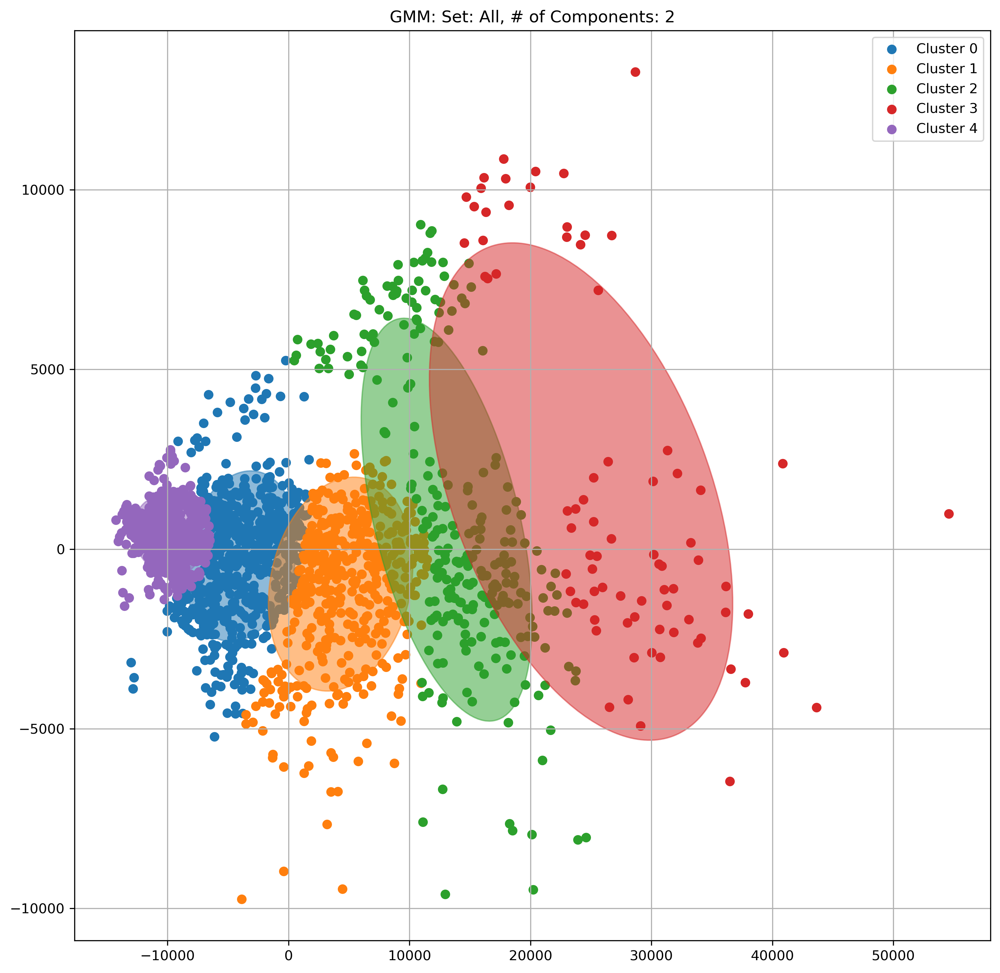

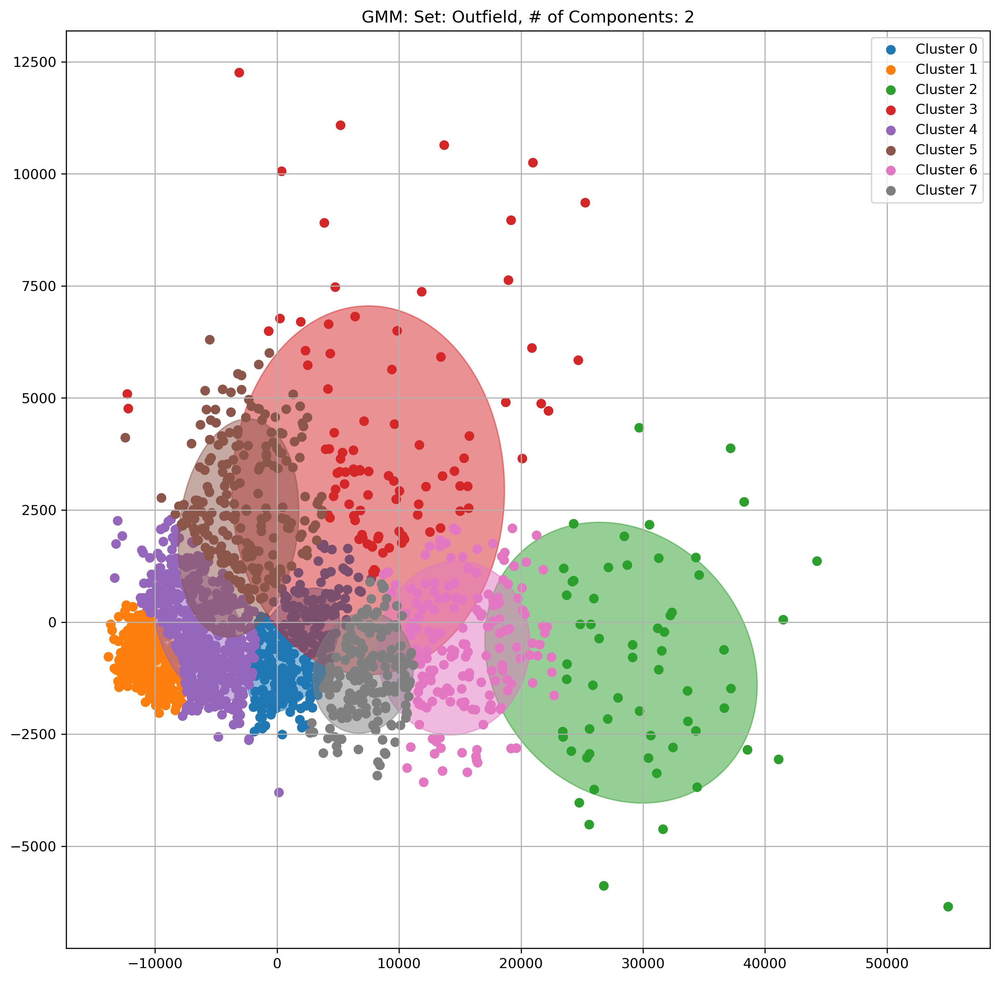

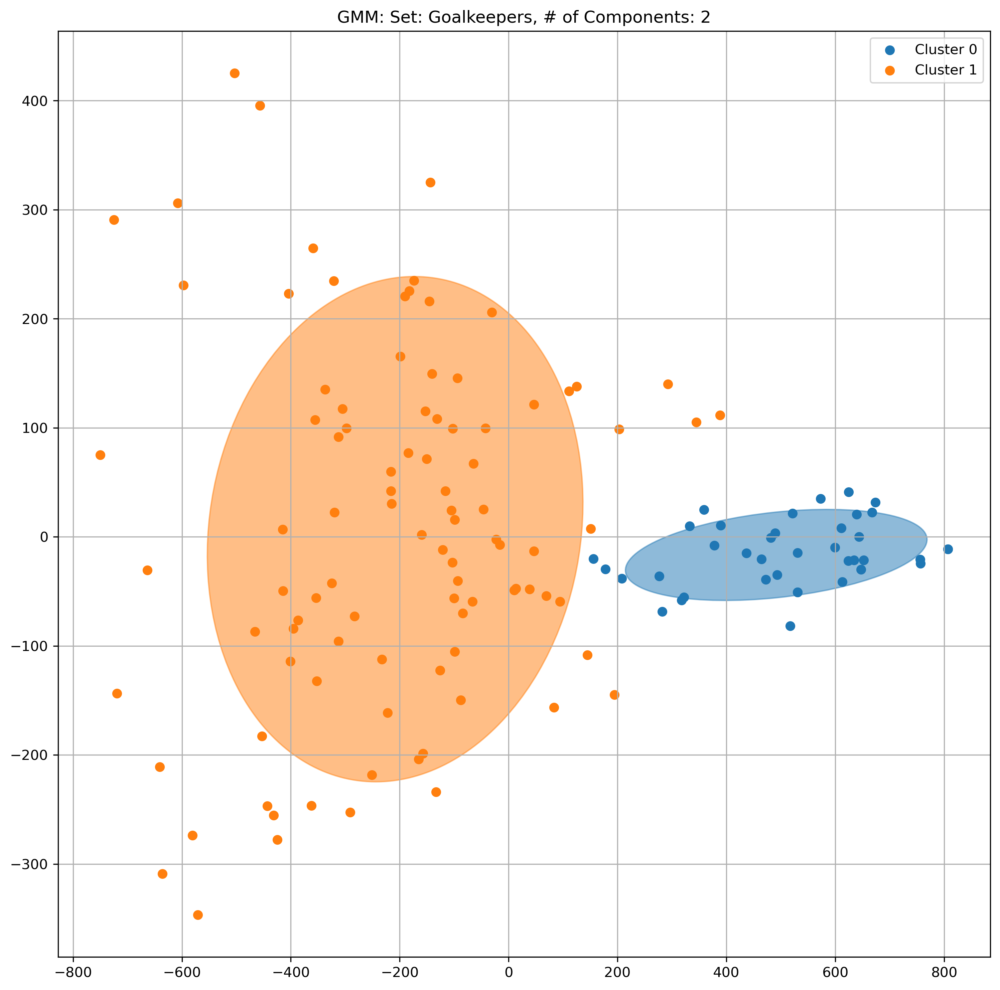

In [18]:
for key in data_dict.keys():

    gmm2 = GaussianMixture(n_components=data_dict[key]['PCA2']['clusters']['gmm'], covariance_type="full")
    gmm2.fit(data_dict[key]['PCA2']['df'])
    gmm3 = GaussianMixture(n_components=data_dict[key]['PCA3']['clusters']['gmm'], covariance_type="full")
    gmm3.fit(data_dict[key]['PCA3']['df'])
    
    data_dict[key]['PCA2']['labels']['gmm'] = gmm2.predict(data_dict[key]['PCA2']['df'])
    data_dict[key]['PCA3']['labels']['gmm'] = gmm3.predict(data_dict[key]['PCA3']['df'])
 
    plot_results(data_dict[key]['PCA2']['df'].to_numpy(), gmm2.predict(data_dict[key]['PCA2']['df']),
                 gmm2.means_, gmm2.covariances_, 'GMM: Set: {}, # of Components: 2'.format(key))
        

## Spectral Clustering

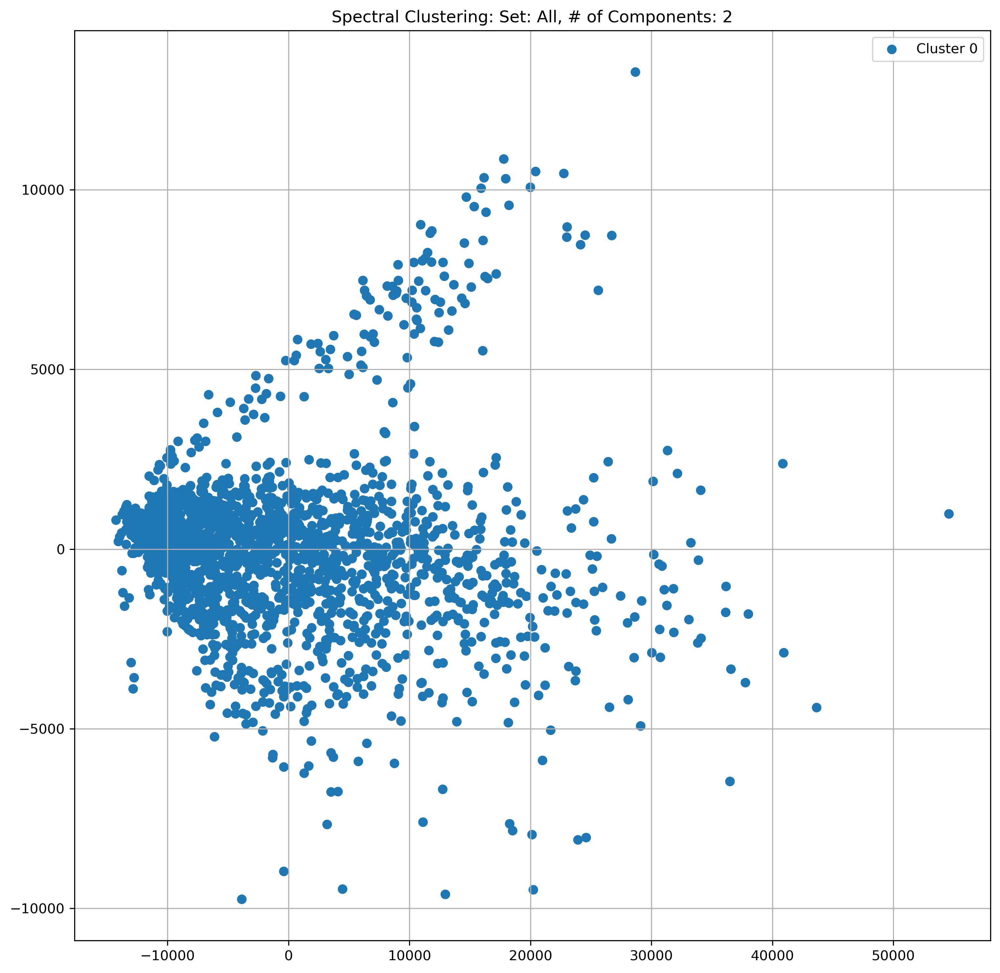

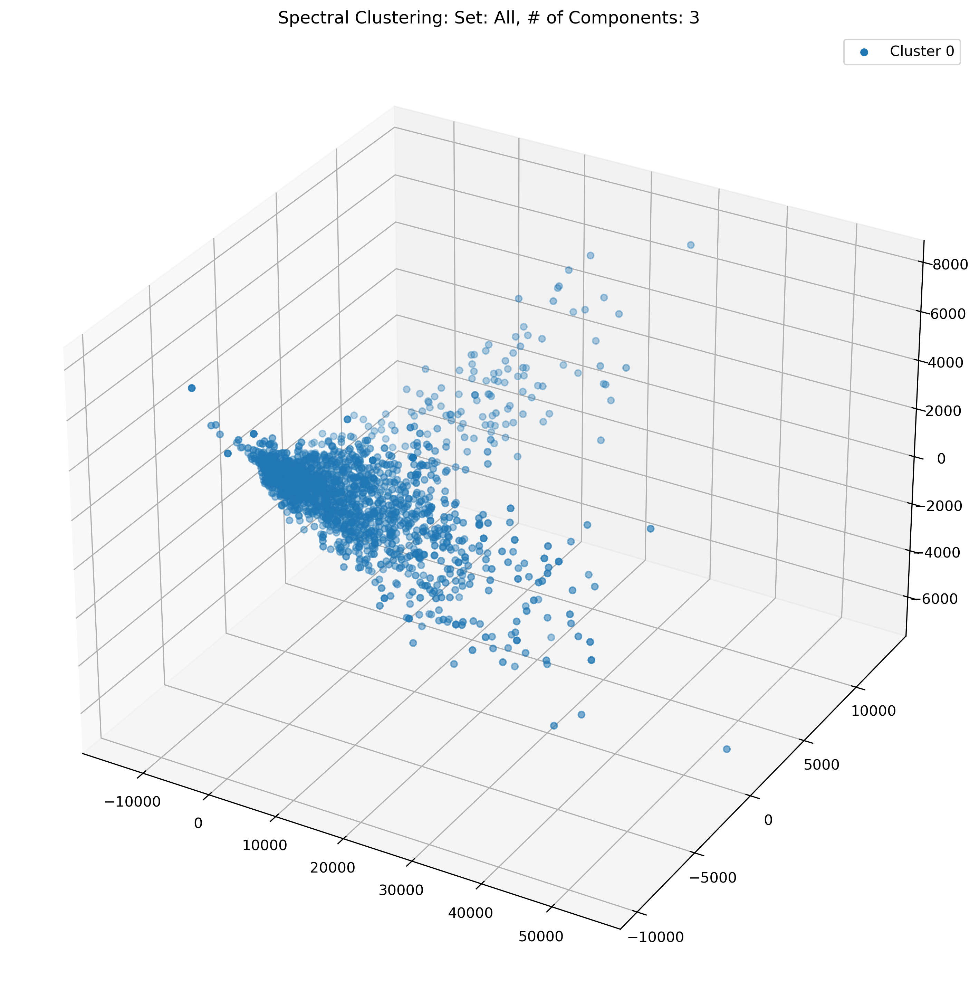

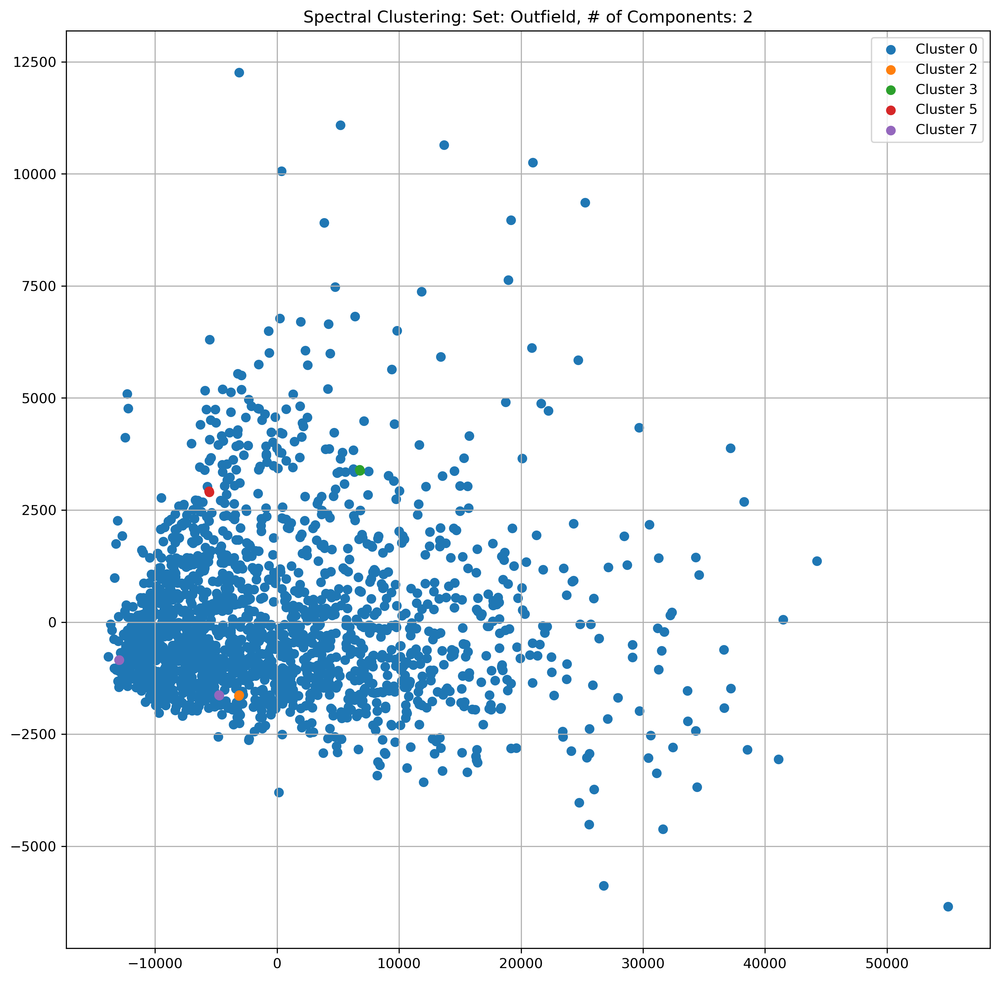

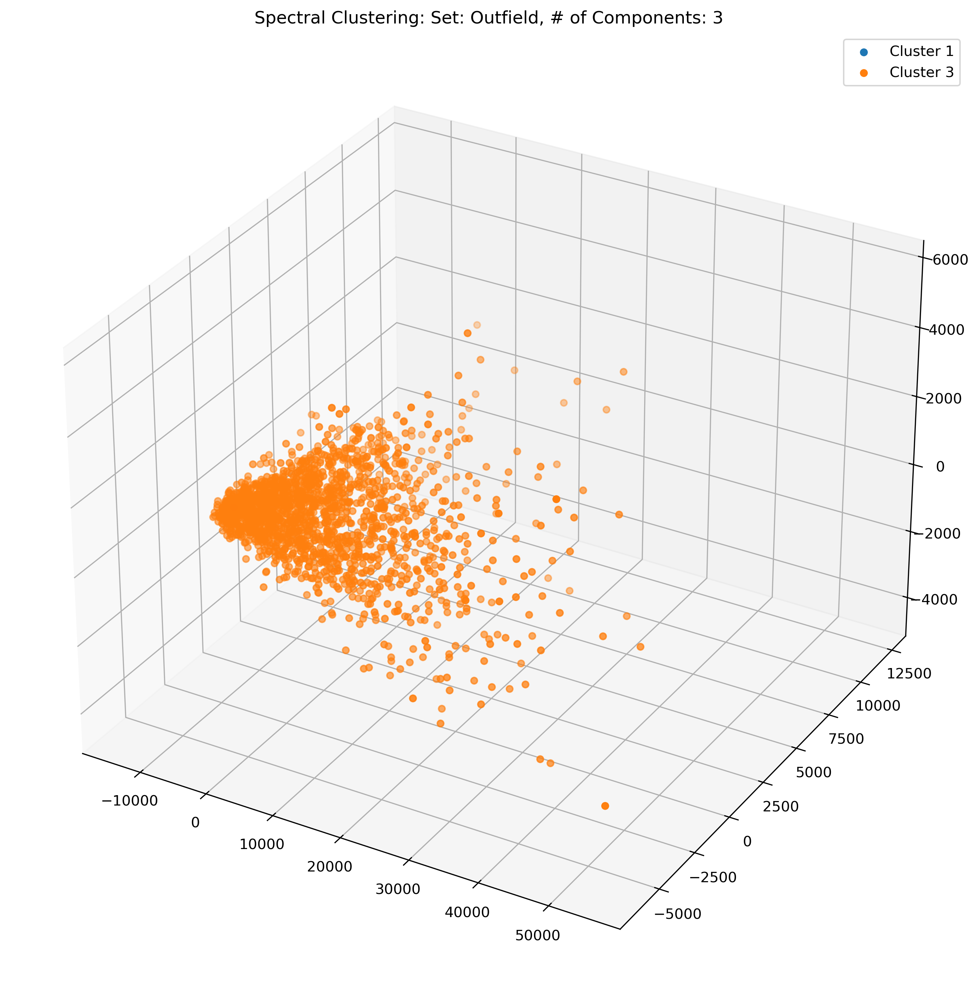

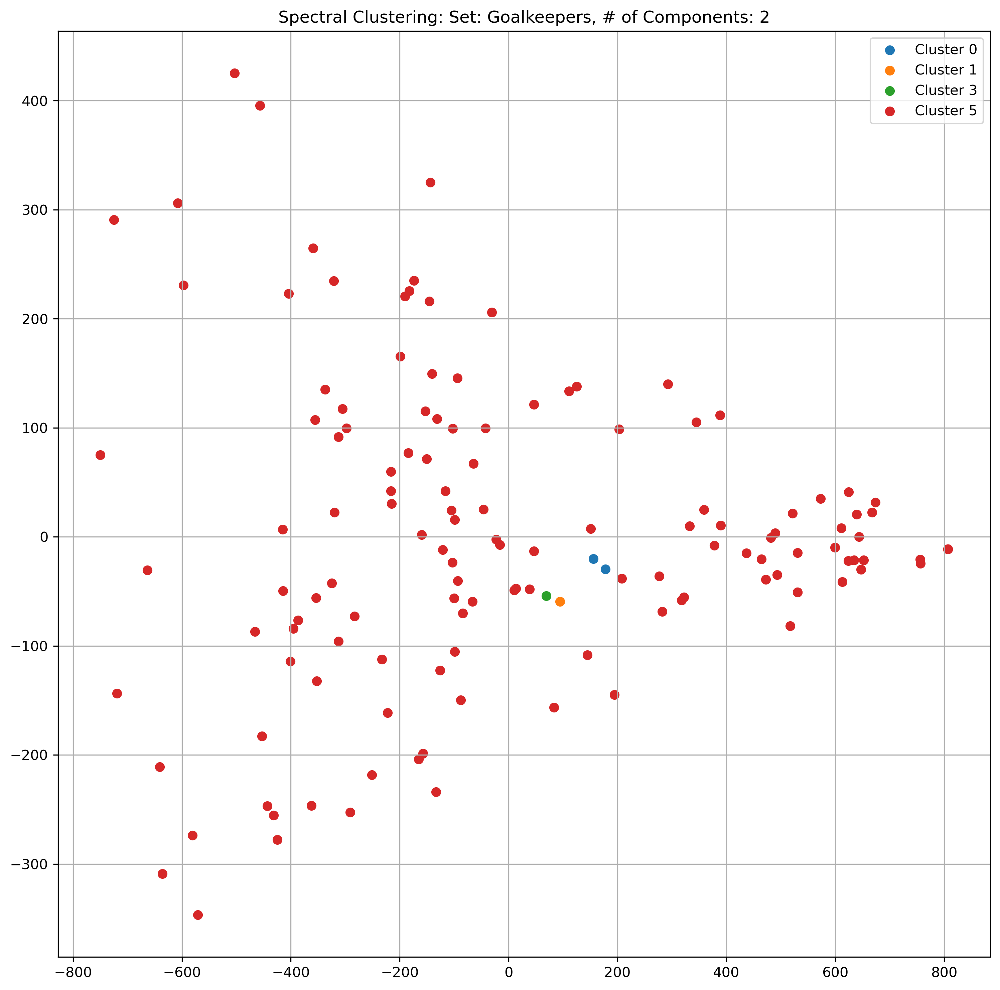

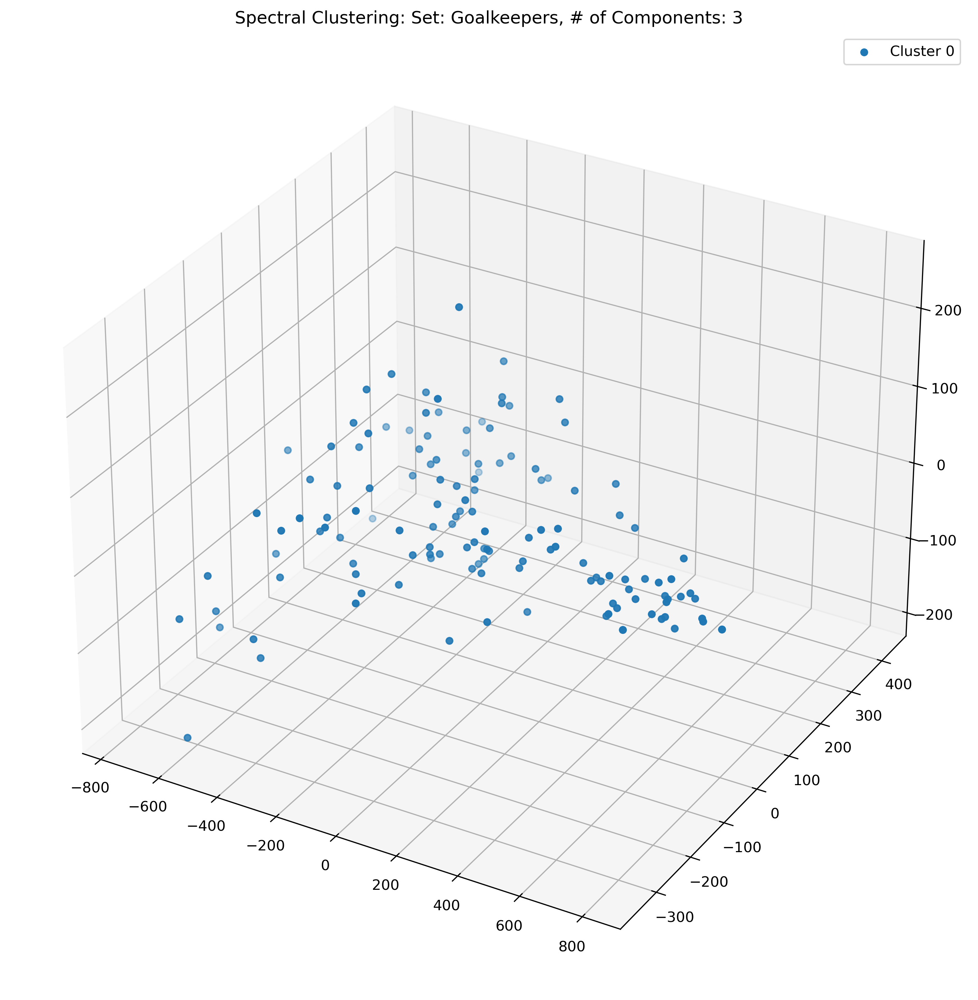

In [19]:
for key in data_dict.keys():

    sc2 = SpectralClustering(n_components=data_dict[key]['PCA2']['clusters']['sc']).fit(data_dict[key]['PCA2']['df'])
    sc3 = SpectralClustering(n_components=data_dict[key]['PCA3']['clusters']['sc']).fit(data_dict[key]['PCA3']['df'])
    
    data_dict[key]['PCA2']['labels']['sc'] = sc2.labels_
    data_dict[key]['PCA3']['labels']['sc'] = sc3.labels_

    temp_df = data_dict[key]['PCA2']['df'].copy()
    temp_df['label'] = data_dict[key]['PCA2']['labels']['sc']
    groups = temp_df.groupby('label')
    
    fig = plt.figure(figsize=(12,12), dpi=300)
    axs = fig.add_subplot()
    for name, group in groups:
        axs.scatter(group['PCA0'], group['PCA1'], label='Cluster {}'.format(name))
    axs.legend()
    axs.grid()
    axs.set_title('Spectral Clustering: Set: {}, # of Components: 2'.format(key))

    temp_df = data_dict[key]['PCA3']['df']
    temp_df['label'] = data_dict[key]['PCA3']['labels']['sc']
    groups = temp_df.groupby('label')
    
    fig = plt.figure(figsize=(12,12), dpi=300)
    axs = fig.add_subplot(projection='3d')
    for name, group in groups:
        axs.scatter(group['PCA0'], group['PCA1'], group['PCA2'], label='Cluster {}'.format(name))
    axs.legend()
    axs.grid()
    axs.set_title('Spectral Clustering: Set: {}, # of Components: 3'.format(key))

# Calculation of Scores

## K-Means

In [20]:
for key in data_dict.keys():
    data_dict[key]['PCA2']['scores'] = {}
    data_dict[key]['PCA3']['scores'] = {}
    data_dict[key]['PCA2']['scores']['k_means'] = calinski_harabasz_score(data_dict[key]['PCA2']['df'], data_dict[key]['PCA2']['labels']['k_means'])
    data_dict[key]['PCA3']['scores']['k_means'] = calinski_harabasz_score(data_dict[key]['PCA3']['df'], data_dict[key]['PCA3']['labels']['k_means'])
    data_dict[key]['PCA2']['scores']['gmm'] = calinski_harabasz_score(data_dict[key]['PCA2']['df'], data_dict[key]['PCA2']['labels']['gmm'])
    data_dict[key]['PCA3']['scores']['gmm'] = calinski_harabasz_score(data_dict[key]['PCA3']['df'], data_dict[key]['PCA3']['labels']['gmm'])
    try:
        data_dict[key]['PCA2']['scores']['sc'] = calinski_harabasz_score(data_dict[key]['PCA2']['df'], data_dict[key]['PCA2']['labels']['sc'])
    except Exception:
        data_dict[key]['PCA2']['scores']['sc'] = 0    
    try:
        data_dict[key]['PCA3']['scores']['sc'] = calinski_harabasz_score(data_dict[key]['PCA3']['df'], data_dict[key]['PCA3']['labels']['sc'])
    except Exception:
        data_dict[key]['PCA3']['scores']['sc'] = 0

In [78]:
pop_pcts = []
all_pos = list(data_dict['Outfield']['positions'])
for pos in set(all_pos):
    pop_pcts.append((pos, len([x for x in all_pos if x == pos])/len(all_pos)))
pop_pcts = [x[1]*100 for x in sorted(pop_pcts)]
pop_pcts

[0.054674685620557675,
 21.432476763258613,
 8.310552214324767,
 9.950792782941498,
 13.996719518862765,
 6.61563696008748,
 6.61563696008748,
 1.3121924548933843,
 4.866047020229634,
 15.691634773100056,
 8.638600328048113,
 1.5855658829961725,
 0.9294696555494806]

In [147]:
temp_gmm2 = GaussianMixture(n_components=data_dict['Outfield']['PCA2']['clusters']['gmm'], covariance_type="full")
temp_gmm2.fit(data_dict['Outfield']['PCA2']['df'])
predict = temp_gmm2.predict(data_dict['Outfield']['PCA2']['df'])

In [148]:
temp_df = pd.DataFrame([list(predict), list(data_dict['Outfield']['positions'])]).T
temp_df.columns = ['GMM_Label', 'Position']
groups = temp_df.groupby('GMM_Label')

gmm_pcts = []
all_pos = sorted(list(set(list(data_dict['Outfield']['positions']))))

for name, group in groups:
    pcts = []
    for pos in all_pos:
        pcts.append((pos, len([x for x in group['Position'] if x == pos])/len(group)))
    gmm_pcts.append([x[1]*100 for x in sorted(pcts)])

([0, 1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 11, 12],
 [Text(0, 0, 'Central Midfield'),
  Text(1, 0, 'Defender - Centre-Back'),
  Text(2, 0, 'Defender - Left-Back'),
  Text(3, 0, 'Defender - Right-Back'),
  Text(4, 0, 'Forward - Centre-Forward'),
  Text(5, 0, 'Forward - Left Winger'),
  Text(6, 0, 'Forward - Right Winger'),
  Text(7, 0, 'Forward - Second Striker'),
  Text(8, 0, 'Midfielder - Attacking Midfield'),
  Text(9, 0, 'Midfielder - Central Midfield'),
  Text(10, 0, 'Midfielder - Defensive Midfield'),
  Text(11, 0, 'Midfielder - Left Midfield'),
  Text(12, 0, 'Midfielder - Right Midfield')])

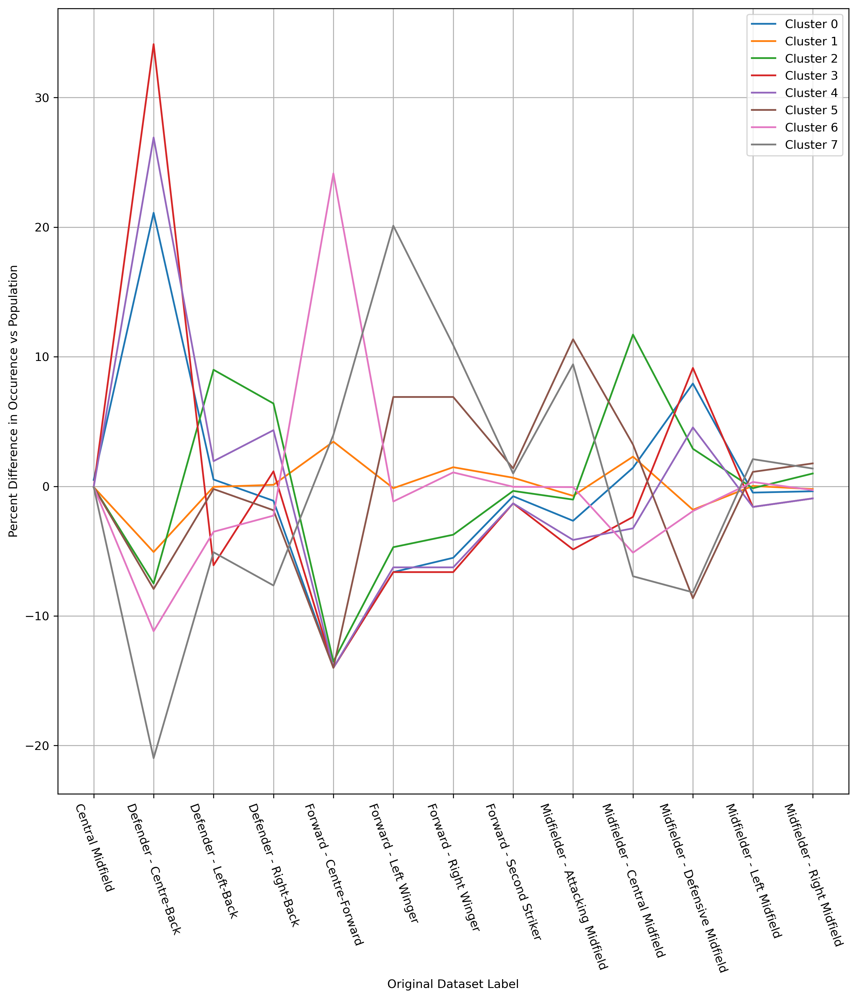

In [149]:
fig = plt.figure(figsize=(12,12), dpi=300)
axs = fig.add_subplot()
for i, pcts in enumerate(gmm_pcts):
    axs.plot(all_pos, [x[0]-x[1] for x in zip(pcts, pop_pcts)], label='Cluster {}'.format(i))
    
axs.grid()
axs.legend()
axs.set_xlabel('Original Dataset Label')
axs.set_ylabel('Percent Difference in Occurence vs Population')
plt.xticks(rotation=-70)

In [150]:
temp2_df = pd.DataFrame([list(predict), list(data_dict['Outfield']['positions'])
                        , list(data_dict['Outfield']['players'])]).T
temp2_df.columns = ['GMM_Label', 'Position', 'Player']

In [151]:
temp2_df.iloc[1337]

GMM_Label                                  3
Position     Midfielder - Defensive Midfield
Player                              Casemiro
Name: 1337, dtype: object

In [152]:
temp3_df = temp2_df[temp2_df['GMM_Label'] == 3]
list(temp3_df[temp3_df['Position'] != 'Defender - Centre-Back']['Player'])

['Sergio Busquets',
 'Joshua Kimmich',
 'Benjamin Pavard',
 'CĂ©sar Azpilicueta',
 'Jorginho',
 'Marcelo Brozovic',
 'Trent Alexander-Arnold',
 'Andrew Robertson',
 'Fernandinho',
 'Rodri',
 'Kyle Walker',
 'FabiĂˇn Ruiz PeĂ±a',
 'Dani Carvajal',
 'Casemiro',
 'Toni Kroos',
 'Ă‰ver Banega',
 'Oliver Norwood',
 'Daniel Parejo',
 'JoĂŁo Moutinho',
 'RĂşben Neves']

In [153]:
tempy_df = data_dict['Outfield']['players'].copy()
tempy_df = tempy_df.reset_index()

In [154]:
tempy_df

,index,player
0,0,Martin Aguirregabiria
1,1,Oliver Burke
2,2,VĂ­ctor Camarasa
3,3,RubĂ©n Duarte
4,4,Rodrigo Ely
...,...,...
1824,2636,Pedro Neto
1825,2637,RĂşben Neves
1826,2640,Romain SaĂŻss
1827,2641,Adama TraorĂ©


In [155]:
tempy_df.loc[tempy_df['player'] == 'Casemiro']

,index,player
1337,1927,Casemiro


In [156]:
temp_gmm2 = GaussianMixture(n_components=data_dict['Outfield']['PCA2']['clusters']['gmm'], covariance_type="full")
temp_gmm2.fit(data_dict['Outfield']['PCA2']['df'])
[print(x) for x in temp_gmm2.predict_proba(data_dict['Outfield']['PCA2']['df'])[1337]]

3.4932467538717993e-67
0.05277528057085731
7.201052828854942e-12
0.8098567267112515
7.844226239036277e-19
7.409071398777687e-15
0.13736799271068437
0.0


[None, None, None, None, None, None, None, None]

In [142]:
data_dict['Outfield']['df'].iloc[1337]

goals                4.0
assists              3.0
pens_made            0.0
pens_att             0.0
cards_yellow        12.0
                   ...  
own_goals            0.0
ball_recoveries    490.0
aerials_won         92.0
aerials_lost        52.0
aerials_won_pct     63.9
Name: 1927, Length: 127, dtype: float64

In [144]:
data_dict['Outfield']['players'].iloc[1337]

'Casemiro'

In [140]:
temp_gmm2.predict(data_dict['Outfield']['PCA2']['df'])[1337]

4